In [ ]:
from google.colab import drive

# Mount Google Drive to your Colab runtime
drive.mount('/content/drive')

# Navigate to your dataset location
%cd /content/drive/MyDrive/

Mounted at /content/drive
/content/drive/MyDrive


In [ ]:
# Install unzip if needed (usually pre-installed in Colab)
!apt install unzip

# Unzip your dataset (replace with your exact filename)
!unzip "/content/drive/MyDrive/dataset.zip" -d "/content/"

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/train/6a826aac72.jpg  
  inflating: /content/dataset/train/6a89638029.jpg  
  inflating: /content/dataset/train/6aa1028635.jpg  
  inflating: /content/dataset/train/6aad909602.jpg  
  inflating: /content/dataset/train/6aae904dfc.jpg  
  inflating: /content/dataset/train/6ab9e294c5.jpg  
  inflating: /content/dataset/train/6ac4cf22ca.jpg  
  inflating: /content/dataset/train/6acd6d71ce.jpg  
  inflating: /content/dataset/train/6acd6f5382.jpg  
  inflating: /content/dataset/train/6ad21d4503.jpg  
  inflating: /content/dataset/train/6ad8c083f9.jpg  
  inflating: /content/dataset/train/6add7c7f0f.jpg  
  inflating: /content/dataset/train/6ae4cd7123.jpg  
  inflating: /content/dataset/train/6aec461162.jpg  
  inflating: /content/dataset/train/6aeee71cda.jpg  
  inflating: /content/dataset/train/6af8a83680.jpg  
  inflating: /content/dataset/train/6afa55426d.jpg  
  inflating: /content/dataset/train/6afae306b3.j

#Describe data

In [ ]:
# Verify the unzipped contents
!ls "/content/dataset"

sample_submission.csv  test  test.csv  train  train.csv


In [ ]:
import os
# Define your dataset paths (adjust according to your actual folder structure)
train = "/content/dataset/train"
test = "/content/dataset/test"

# Count number of classes (folders) in train and test
print("Number of training classes:", len(os.listdir(train)))
print("Number of test classes:", len(os.listdir(test)))

Number of training classes: 8227
Number of test classes: 2056


In [ ]:
import pandas as pd
labels_train = pd.read_csv('/content/dataset/train.csv')
labels_train

,image_ID,label
0,7c225f7b61.jpg,Badminton
1,b31.jpg,Badminton
2,acb146546c.jpg,Badminton
3,0e62f4d8f2.jpg,Badminton
4,cfd2c28c74.jpg,Cricket
...,...,...
8222,903d2fffb3.jpg,Cricket
8223,b5f174c688.jpg,Badminton
8224,2433770a67.jpg,Tennis
8225,6403964166.jpg,Tennis


In [ ]:
print(labels_train['label'].value_counts())

label
Cricket      1556
Wrestling    1471
Tennis       1445
Badminton    1394
Soccer       1188
Swimming      595
Karate        578
Name: count, dtype: int64


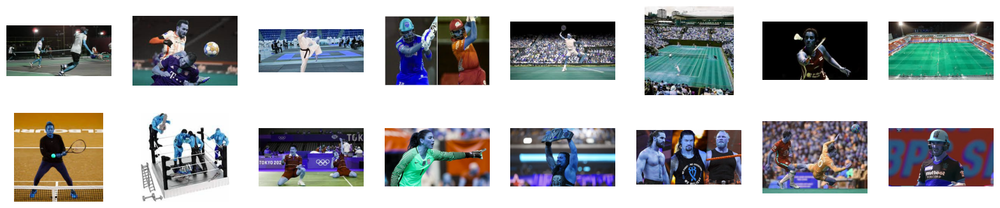

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt
rand_images = random.sample(os.listdir(train), 16)

fig = plt.figure(figsize=(20,4))
for i, im in enumerate(rand_images):
    plt.subplot(2, 8, i+1)
    im = cv2.imread(os.path.join(train, im))
    plt.imshow(im)
    plt.axis('off')
plt.show()

In [ ]:
import pandas as pd
import os
from PIL import Image
import matplotlib.pyplot as plt
from collections import Counter

# Define paths (adjust these based on your local setup)
train_csv_path = '/content/dataset/train.csv'
train_images_path = '/content/dataset/train'

# 1. Load and describe the train.csv file
print("Loading train.csv...")
train_df = pd.read_csv(train_csv_path)
print("\nDataset Description from train.csv:")
print(f"Total number of entries: {len(train_df)}")
print("\nColumns in train.csv:")
print(train_df.columns.tolist())
print("\nFirst few rows of train.csv:")
print(train_df.head())

# Analyze label distribution
labels = train_df['label'].tolist()
label_counts = Counter(labels)
print("\nLabel Distribution:")
for label, count in label_counts.items():
    print(f"{label}: {count} images")

# 2. Analyze images in the train folder
print("\nAnalyzing images in train folder...")
image_files = [f for f in os.listdir(train_images_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
print(f"Total number of images found: {len(image_files)}")

# Check image properties (dimensions, channels)
image_dims = []
channels = []
for img_file in image_files[:100]:  # Limit to first 100 for efficiency
    try:
        img_path = os.path.join(train_images_path, img_file)
        with Image.open(img_path) as img:
            image_dims.append(img.size)  # (width, height)
            channels.append(len(img.getbands()))  # Number of channels (e.g., 3 for RGB)
    except Exception as e:
        print(f"Error processing {img_file}: {e}")

# Summarize image properties
if image_dims:
    widths, heights = zip(*image_dims)
    avg_width = sum(widths) / len(widths)
    avg_height = sum(heights) / len(heights)
    unique_dims = len(set(image_dims))
    channel_counts = Counter(channels)
    print("\nImage Properties (based on sample):")
    print(f"Average image width: {avg_width:.2f} pixels")
    print(f"Average image height: {avg_height:.2f} pixels")
    print(f"Number of unique dimensions: {unique_dims}")
    print(f"Channel distribution: {dict(channel_counts)} (e.g., 3 = RGB, 1 = Grayscale)")

# 3. Visualize label distribution
plt.figure(figsize=(10, 6))
plt.bar(label_counts.keys(), label_counts.values())
plt.xlabel('Sports Labels')
plt.ylabel('Number of Images')
plt.title('Label Distribution in Sports Image Classification Dataset')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('label_distribution.png')
plt.close()

# 4. Additional checks
# Verify if all images in train folder have corresponding entries in train.csv
csv_image_ids = set(train_df['image_ID'].apply(lambda x: str(x)).tolist())
image_filenames = set([os.path.splitext(f)[0] for f in image_files])
missing_in_csv = image_filenames - csv_image_ids
missing_in_folder = csv_image_ids - image_filenames
print("\nConsistency Check:")
print(f"Images in folder but not in CSV: {len(missing_in_csv)}")
print(f"Images in CSV but not in folder: {len(missing_in_folder)}")

# Summary
print("\nDataset Summary:")
print(f"- The dataset contains {len(train_df)} labeled entries in train.csv.")
print(f"- There are {len(image_files)} images in the train folder.")
print(f"- Labels include {len(label_counts)} unique categories.")
print(f"- Images have varying dimensions, with an average size of {avg_width:.2f}x{avg_height:.2f} pixels.")
print(f"- Most images are likely RGB (3 channels) based on sample analysis.")
if missing_in_csv or missing_in_folder:
    print("- There are inconsistencies between CSV entries and image files that may need cleaning.")

Loading train.csv...

Dataset Description from train.csv:
Total number of entries: 8227

Columns in train.csv:
['image_ID', 'label']

First few rows of train.csv:
         image_ID      label
0  7c225f7b61.jpg  Badminton
1         b31.jpg  Badminton
2  acb146546c.jpg  Badminton
3  0e62f4d8f2.jpg  Badminton
4  cfd2c28c74.jpg    Cricket

Label Distribution:
Badminton: 1394 images
Cricket: 1556 images
Tennis: 1445 images
Swimming: 595 images
Soccer: 1188 images
Wrestling: 1471 images
Karate: 578 images

Analyzing images in train folder...
Total number of images found: 8227

Image Properties (based on sample):
Average image width: 629.58 pixels
Average image height: 416.02 pixels
Number of unique dimensions: 65
Channel distribution: {3: 95, 4: 5} (e.g., 3 = RGB, 1 = Grayscale)

Consistency Check:
Images in folder but not in CSV: 8227
Images in CSV but not in folder: 8227

Dataset Summary:
- The dataset contains 8227 labeled entries in train.csv.
- There are 8227 images in the train folder.

In [ ]:
import pandas as pd
import os
from PIL import Image
import numpy as np
from collections import Counter

# Define the train path for Kaggle
train = "/content/dataset/train"

# Get list of image files
image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')
image_files = [f for f in os.listdir(train) if f.lower().endswith(image_extensions)]
print(f"Total number of images found: {len(image_files)}")

# Analyze image properties
image_dims = []
channels = []
grayscale_images = []
pseudo_grayscale_images = []
error_files = []

for img_file in image_files:
    try:
        img_path = os.path.join(train, img_file)
        with Image.open(img_path) as img:
            image_dims.append(img.size)
            num_channels = len(img.getbands())
            channels.append(num_channels)
            if num_channels == 1:
                grayscale_images.append(img_file)
            elif num_channels == 3:  # Check for pseudo-grayscale in RGB images
                img_array = np.array(img)
                # Check if R, G, B channels are identical
                if (img_array[:,:,0] == img_array[:,:,1]).all() and (img_array[:,:,1] == img_array[:,:,2]).all():
                    pseudo_grayscale_images.append(img_file)
    except Exception as e:
        error_files.append((img_file, str(e)))

# Summarize image properties
if image_dims:
    widths, heights = zip(*image_dims)
    avg_width = sum(widths) / len(widths)
    avg_height = sum(heights) / len(heights)
    unique_dims = len(set(image_dims))
    channel_counts = Counter(channels)
    print("\nImage Properties (based on all images):")
    print(f"Average image width: {avg_width:.2f} pixels")
    print(f"Average image height: {avg_height:.2f} pixels")
    print(f"Number of unique dimensions: {unique_dims}")
    print(f"Channel distribution: {dict(channel_counts)} (1 = Grayscale, 3 = RGB, 4 = RGBA)")

# Report grayscale images
print("\nGrayscale Images (1 channel):")
if grayscale_images:
    print(f"Found {len(grayscale_images)} grayscale images:")
    for img in grayscale_images:
        print(f"- {img}")
else:
    print("No grayscale images found.")

# Report pseudo-grayscale RGB images
print("\nPseudo-Grayscale RGB Images (identical R,G,B channels):")
if pseudo_grayscale_images:
    print(f"Found {len(pseudo_grayscale_images)} RGB images that are effectively grayscale:")
    for img in sorted(pseudo_grayscale_images):
        print(f"- {img}")
else:
    print("No pseudo-grayscale RGB images found.")

# Report errors
print("\nError Files:")
if error_files:
    print(f"Found {len(error_files)} files with errors:")
    for img_file, error in error_files:
        print(f"- {img_file}: {error}")
else:
    print("No errors encountered during image processing.")

# Continuation: Convert RGBA images to RGB and verify conversion
# Define output directory for converted images
output_images_path = '/content/dataset/train_rgb'

# Ensure output directory exists
try:
    os.makedirs(output_images_path, exist_ok=True)
    print(f"Output directory created or exists: {output_images_path}")
except Exception as e:
    print(f"Error creating output directory: {e}")
    raise

# 1. Convert images to RGB (focusing on RGBA but processing all for consistency)
print("\nConverting images to RGB format...")
converted_count = 0
conversion_errors = []

for img_file in image_files:
    try:
        img_path = os.path.join(train, img_file)
        # Preserve original extension for output, but save as JPEG or PNG
        output_file = os.path.splitext(img_file)[0] + '.jpg'  # Force JPEG output
        output_path = os.path.join(output_images_path, output_file)

        # Verify input file exists
        if not os.path.exists(img_path):
            raise FileNotFoundError(f"Input file not found: {img_path}")

        # Load and convert image to RGB
        with Image.open(img_path) as img:
            rgb_img = img.convert('RGB')
            rgb_img.save(output_path, format='JPEG', quality=95)  # Explicitly save as JPEG
            converted_count += 1
    except Exception as e:
        conversion_errors.append((img_file, str(e)))

# Report conversion results
print(f"Successfully converted {converted_count} images to RGB.")
if conversion_errors:
    print(f"Errors encountered for {len(conversion_errors)} files during conversion:")
    for img_file, error in conversion_errors[:10]:  # Limit to first 10 for brevity
        print(f"- {img_file}: {error}")
    if len(conversion_errors) > 10:
        print(f"...and {len(conversion_errors) - 10} more errors.")
else:
    print("No errors encountered during conversion.")

# 2. Verify channel distribution of converted images
print("\nVerifying converted images in train_rgb folder...")
converted_files = [f for f in os.listdir(output_images_path) if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif'))]
converted_channels = []

for img_file in converted_files:
    try:
        img_path = os.path.join(output_images_path, img_file)
        with Image.open(img_path) as img:
            num_channels = len(img.getbands())
            converted_channels.append(num_channels)
    except Exception as e:
        print(f"Error verifying {img_file}: {e}")

# Check channel distribution
channel_counts_converted = Counter(converted_channels)
print("\nConverted Channel Distribution:")
print(f"Channel counts: {dict(channel_counts_converted)} (should all be 3 = RGB)")

# 3. Confirm all images are RGB
if all(channel == 3 for channel in converted_channels) and len(converted_files) == len(image_files):
    print("\nAll images are now converted to RGB.")
else:
    print("\nWarning: Not all images are RGB or some images failed to convert.")
    if len(converted_files) != len(image_files):
        print(f"Expected {len(image_files)} images, but found {len(converted_files)} in output folder.")
    if any(channel != 3 for channel in converted_channels):
        print(f"Found non-RGB images with channels: {dict(channel_counts_converted)}")

Total number of images found: 8227

Image Properties (based on all images):
Average image width: 622.75 pixels
Average image height: 410.63 pixels
Number of unique dimensions: 2102
Channel distribution: {3: 7909, 4: 318} (1 = Grayscale, 3 = RGB, 4 = RGBA)

Grayscale Images (1 channel):
No grayscale images found.

Pseudo-Grayscale RGB Images (identical R,G,B channels):
Found 67 RGB images that are effectively grayscale:
- 0565e99774.jpg
- 072534c231.jpg
- 09af66bc15.jpg
- 0a53a621dc.jpg
- 0b8254f672.jpg
- 0c27e8b895.jpg
- 0f7292aaed.jpg
- 1073117687.jpg
- 12f9dd0508.jpg
- 161c476486.jpg
- 178adec81b.jpg
- 18543f145f.jpg
- 18c5df9680.jpg
- 1a5c69697c.jpg
- 21a811c5ce.jpg
- 24f6236342.jpg
- 2ebecfe199.jpg
- 34c4ffe531.jpg
- 37fdb15e70.jpg
- 39ff052a4e.jpg
- 3e359029e6.jpg
- 3f05960667.jpg
- 3f62b0f3cf.jpg
- 42edb37438.jpg
- 458f7139e2.jpg
- 484666d6bf.jpg
- 4b0bc07882.jpg
- 4b4aadc855.jpg
- 50b30fd5f8.jpg
- 51262b250b.jpg
- 54570d08d5.jpg
- 5d53afd830.jpg
- 625ac9bc37.jpg
- 640f3e3682.jpg

In [ ]:
import os
from PIL import Image
from collections import Counter

# Define input path
input_images_path = '/content/dataset/train_rgb'

# Supported image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')

# Check if input directory exists
if not os.path.exists(input_images_path):
    print(f"Error: Directory {input_images_path} does not exist.")
    print("Ensure the previous code to create train_rgb ran successfully.")
    print("Check available directories in /content/dataset/:")
    print(os.listdir('/content/dataset') if os.path.exists('/content/dataset') else "No /content/dataset/ directory")
    raise FileNotFoundError(f"Directory {input_images_path} not found")

# List image files
image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(image_extensions)]
total_images = len(image_files)

print(f"\nTotal number of images found in {input_images_path}: {total_images}")
if total_images == 0:
    print("Warning: No images found in train_rgb. The folder is empty.")
    print("Check the contents of the directory:")
    print(os.listdir(input_images_path) if os.path.exists(input_images_path) else "Directory empty")
    print("Ensure the previous RGB conversion code ran correctly.")
else:
    print("\nFirst 10 images in train_rgb (or fewer if less than 10):")
    for img_file in image_files[:10]:
        print(f"- {img_file}")
    if total_images > 10:
        print(f"...and {total_images - 10} more images.")

# 1. Check for images with non-.jpg extensions or non-JPEG formats
print("\nChecking for images with non-.jpg extensions or non-JPEG formats in train_rgb...")
non_jpg_extensions = []
non_jpeg_formats = []
error_files = []

for img_file in image_files:
    try:
        img_path = os.path.join(input_images_path, img_file)
        extension = os.path.splitext(img_file)[1].lower()
        if extension != '.jpg':
            non_jpg_extensions.append(img_file)
        with Image.open(img_path) as img:
            img_format = img.format
            if img_format != 'JPEG':
                non_jpeg_formats.append(img_file)
    except Exception as e:
        error_files.append((img_file, str(e)))

print("\nNon-Standard Images Summary:")
print(f"Images with non-.jpg extensions: {len(non_jpg_extensions)}")
if non_jpg_extensions:
    print("Examples of non-.jpg extension files (up to 5):")
    for img_file in non_jpg_extensions[:5]:
        print(f"- {img_file}")
print(f"Images with non-JPEG formats: {len(non_jpeg_formats)}")
if non_jpeg_formats:
    print("Examples of non-JPEG format files (up to 5):")
    for img_file in non_jpeg_formats[:5]:
        print(f"- {img_file}")
if not non_jpg_extensions and not non_jpeg_formats:
    print("All images have .jpg extension and JPEG format.")
if error_files:
    print(f"\nErrors during check: {len(error_files)} files")
    for img_file, error in error_files:
        print(f"- {img_file}: {error}")

# 2. Analyze all extensions and formats in train_rgb
print("\nAnalyzing all extensions and formats in train_rgb folder...")
extensions = [os.path.splitext(f)[1].lower() for f in image_files]
formats = []
error_files = []

for img_file in image_files:
    try:
        img_path = os.path.join(input_images_path, img_file)
        with Image.open(img_path) as img:
            formats.append(img.format)
    except Exception as e:
        error_files.append((img_file, str(e)))

print("\nFile Extension Distribution in train_rgb:")
print(f"Extension counts: {dict(Counter(extensions))}")
print("\nFile Format Distribution in train_rgb:")
print(f"Format counts: {dict(Counter(formats))}")
if error_files:
    print(f"\nErrors during analysis: {len(error_files)} files")
    for img_file, error in error_files:
        print(f"- {img_file}: {error}")
else:
    print("\nNo errors during analysis.")


Total number of images found in /content/dataset/train_rgb: 8227

First 10 images in train_rgb (or fewer if less than 10):
- 39d3bf9c99.jpg
- c3a24e8ff8.jpg
- 9d08b7bd1b.jpg
- eaf03d4ebf.jpg
- 3c4a401f15.jpg
- 9e2b7b280d.jpg
- 6f95e0ca33.jpg
- 4267bf8cf8.jpg
- 68c1ff12bb.jpg
- e236380728.jpg
...and 8217 more images.

Checking for images with non-.jpg extensions or non-JPEG formats in train_rgb...

Non-Standard Images Summary:
Images with non-.jpg extensions: 0
Images with non-JPEG formats: 0
All images have .jpg extension and JPEG format.

Analyzing all extensions and formats in train_rgb folder...

File Extension Distribution in train_rgb:
Extension counts: {'.jpg': 8227}

File Format Distribution in train_rgb:
Format counts: {'JPEG': 8227}

No errors during analysis.


In [ ]:
# import os
# import numpy as np
# from PIL import Image
# from scipy.stats import chi2

# # Define path
# input_images_path = '/content/dataset/train_rgb'

# # Supported image extensions
# image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')

# # Check if directory exists
# if not os.path.exists(input_images_path):
#     print("No outliers found (directory missing).")
#     exit()

# # List image files
# image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(image_extensions)]
# if not image_files:
#     print("No outliers found (no images).")
#     exit()

# # Collect dimensions
# dimensions = []
# file_dims = []
# for img_file in image_files:
#     try:
#         with Image.open(os.path.join(input_images_path, img_file)) as img:
#             width, height = img.size
#             dimensions.append([width, height])
#             file_dims.append((img_file, width, height))
#     except:
#         pass

# dimensions = np.array(dimensions)
# if len(dimensions) == 0:
#     print("No outliers found (no valid images).")
#     exit()

# # Compute Mahalanobis distance
# def mahalanobis_distance(points):
#     mean = np.mean(points, axis=0)
#     cov = np.cov(points, rowvar=False)
#     try:
#         cov_inv = np.linalg.inv(cov)
#     except:
#         return np.array([0] * len(points))
#     delta = points - mean
#     distances = np.sqrt(np.sum((delta @ cov_inv) * delta, axis=1))
#     return distances

# mahal_distances = mahalanobis_distance(dimensions)
# threshold = np.sqrt(chi2.ppf(0.95, df=2))

# # List outliers
# outliers = [(file, w, h) for (file, w, h), d in zip(file_dims, mahal_distances) if d > threshold]

# # Output
# if outliers:
#     print(f"Outliers found in train_rgb ({len(outliers)} images):")
#     for file, w, h in outliers:
#         print(f"- {file}: ({w}, {h})")
# else:
#     print("No outliers found in train_rgb.")

In [ ]:
#images resized to saved in train_resized
import os
from PIL import Image

# Define paths
train_rgb_path = '/content/dataset/train_rgb'
train_resized_path = '/content/dataset/train_resized'

# Supported image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')

# Check if train_rgb exists
if not os.path.exists(train_rgb_path):
    print("Error: train_rgb directory missing.")
    exit()

# List all images in train_rgb
image_files = [f for f in os.listdir(train_rgb_path) if f.lower().endswith(image_extensions)]
if not image_files:
    print("Error: No images found in train_rgb.")
    exit()
print(f"Total images in train_rgb: {len(image_files)}")

# Define aspect ratio-preserving resizing function
def resize_with_padding(img, target_size=(224, 224)):
    img_ratio = img.width / img.height
    target_width, target_height = target_size
    target_ratio = target_width / target_height
    if img_ratio > target_ratio:
        new_width = target_width
        new_height = int(target_width / img_ratio)
    else:
        new_height = target_height
        new_width = int(target_height * img_ratio)
    img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)
    new_img = Image.new('RGB', target_size, (0, 0, 0))  # Black padding
    offset = ((target_width - new_width) // 2, (target_height - new_height) // 2)
    new_img.paste(img, offset)
    return new_img

# Resize all images to 224x224 with padding
os.makedirs(train_resized_path, exist_ok=True)
resized_count = 0
for img_file in image_files:
    try:
        with Image.open(os.path.join(train_rgb_path, img_file)) as img:
            img = resize_with_padding(img.convert('RGB'))
            output_file = os.path.splitext(img_file)[0] + '.jpg'
            img.save(os.path.join(train_resized_path, output_file), quality=95)
            resized_count += 1
    except:
        pass

# Report results
print(f"Resized {resized_count} images to {train_resized_path} at 224x224")
resized_files = [f for f in os.listdir(train_resized_path) if f.lower().endswith(('.jpg', '.jpeg'))]
print(f"Total images in train_resized: {len(resized_files)}")

Total images in train_rgb: 8227
Resized 8227 images to /content/dataset/train_resized at 224x224
Total images in train_resized: 8227


#Data missing or Duplicates


Total images in /content/dataset/train_resized: 8227
Duplicate found: 7c2ad413ef.jpg (matches 1f5a41533f.jpg).
Duplicate found: 11b477cb23.jpg (matches bd1a2ff709.jpg).
Found 2 duplicate images. Displaying duplicates and their matches...


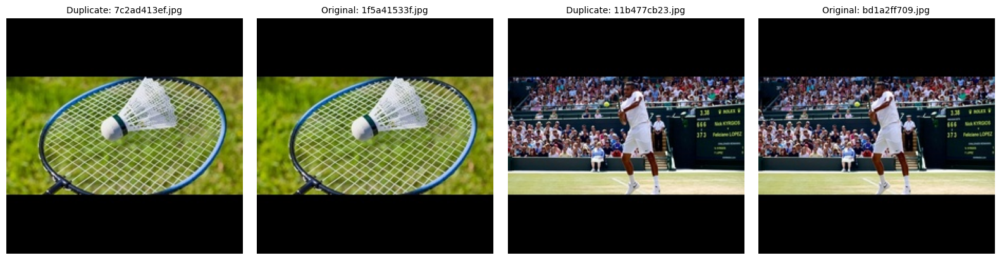

Removed: /content/dataset/train_resized/7c2ad413ef.jpg
Removed: /content/dataset/train_resized/11b477cb23.jpg
Deduplication complete in /content/dataset/train_resized.
Duplicates found: 2
Duplicates removed: 2
Remaining images in /content/dataset/train_resized: 8225


In [ ]:
import hashlib
import os
import cv2
import matplotlib.pyplot as plt

# Define path
output_images_path = '/content/dataset/train_resized'

# Supported image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')

# Check if directory exists
if not os.path.exists(output_images_path):
    print(f"Error: Directory {output_images_path} does not exist.")
    print("Available directories in /content/dataset:")
    print(os.listdir('/content/dataset'))
    exit()

# List all images
image_files = [f for f in os.listdir(output_images_path) if f.lower().endswith(image_extensions)]
if not image_files:
    print(f"Error: No images found in {output_images_path}.")
    exit()
print(f"Total images in {output_images_path}: {len(image_files)}")

# Function to compute MD5 hash
def file_hash(filepath):
    with open(filepath, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

# Deduplicate images and collect duplicates with their matches
hashes = {}
duplicates = []  # List to store (duplicate_filename, duplicate_path, original_filename, original_path)
for f in image_files:
    path = os.path.join(output_images_path, f)
    try:
        file_md5 = file_hash(path)
        if file_md5 in hashes:
            print(f"Duplicate found: {f} (matches {hashes[file_md5]}).")
            duplicates.append((f, path, hashes[file_md5], os.path.join(output_images_path, hashes[file_md5])))
        else:
            hashes[file_md5] = f
    except Exception as e:
        print(f"Error processing {f}: {e}")

# Display duplicate images and their matches if any
if duplicates:
    print(f"Found {len(duplicates)} duplicate images. Displaying duplicates and their matches...")
    num_cols = 4  # Two columns per pair (duplicate + original), so 4 for 2 pairs
    num_rows = len(duplicates)  # One row per duplicate pair
    fig = plt.figure(figsize=(num_cols * 4, num_rows * 4))

    for i, (dup_filename, dup_path, orig_filename, orig_path) in enumerate(duplicates):
        # Display duplicate image
        dup_img = cv2.imread(dup_path)
        if dup_img is not None:
            dup_img = cv2.cvtColor(dup_img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
            plt.subplot(num_rows, num_cols, i * 2 + 1)
            plt.imshow(dup_img)
            plt.title(f"Duplicate: {dup_filename}", fontsize=10)
            plt.axis('off')
        else:
            print(f"Failed to load duplicate image: {dup_path}")

        # Display original image
        orig_img = cv2.imread(orig_path)
        if orig_img is not None:
            orig_img = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
            plt.subplot(num_rows, num_cols, i * 2 + 2)
            plt.imshow(orig_img)
            plt.title(f"Original: {orig_filename}", fontsize=10)
            plt.axis('off')
        else:
            print(f"Failed to load original image: {orig_path}")

    plt.tight_layout()
    plt.show()

    # Automatically delete duplicates
    for _, dup_path, _, _ in duplicates:
        try:
            os.remove(dup_path)
            print(f"Removed: {dup_path}")
        except Exception as e:
            print(f"Error removing {dup_path}: {e}")
else:
    print("No duplicate images found.")

# Report results
remaining_files = [f for f in os.listdir(output_images_path) if f.lower().endswith(image_extensions)]
print(f"Deduplication complete in {output_images_path}.")
print(f"Duplicates found: {len(duplicates)}")
print(f"Duplicates removed: {len(image_files) - len(remaining_files)}")
print(f"Remaining images in {output_images_path}: {len(remaining_files)}")

**Normalization**

In [ ]:
import cv2
import os
import numpy as np

# Define input and output directories
input_folder = '/content/dataset/train_resized'
output_folder = '/content/dataset/image_normalized'

# Create output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Supported image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')

# Function to normalize image to [0, 1]
def normalize_image(image):
    # Convert image to float32 for precision
    image = image.astype(np.float32)
    # Normalize to [0, 1] by dividing by 255 (assuming 8-bit images)
    normalized_image = image / 255.0
    return normalized_image

# Process each image in the input folder
for filename in os.listdir(input_folder):
    if filename.lower().endswith(image_extensions):
        # Read the image
        image_path = os.path.join(input_folder, filename)
        image = cv2.imread(image_path)

        if image is None:
            print(f"Failed to load {filename}")
            continue

        # Normalize the image
        normalized_image = normalize_image(image)

        # Convert back to uint8 for saving (optional, if you need to save as image)
        # If saving, scale back to [0, 255]
        image_to_save = (normalized_image * 255).astype(np.uint8)

        # Save the normalized image
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, image_to_save)
        # print(f"Processed and saved {filename}")
    else:
        print(f"Skipped {filename} (unsupported format)")

print("Normalization complete!")

Normalization complete!


# Data augmentation

In [ ]:
import pandas as pd
import torchvision.transforms as transforms
from PIL import Image
import os
import random

TARGET_SIZE = (224,224)

# Transformations
augmentation = transforms.Compose([
    transforms.Resize(TARGET_SIZE),
    transforms.RandomRotation(degrees=30),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomVerticalFlip(p=0.3),
    transforms.RandomApply([
        transforms.Grayscale(num_output_channels=3)
    ], p=0.3),
    transforms.RandomApply([
        transforms.GaussianBlur(kernel_size=(3, 5), sigma=(0.1, 2))
    ], p=0.3),
    transforms.ToTensor(),
])

to_pil = transforms.ToPILImage()

def augment_class_images(label_name, num_augments):
    # Load CSV
    df = pd.read_csv("/content/dataset/train.csv")
    image_folder = '/content/dataset/image_normalized'

    # Filter by label and remove nan values
    label_rows = df[df['label'] == label_name]
    image_ids = [id for id in label_rows['image_ID'].tolist() if str(id).lower() != 'nan' and pd.notna(id)]

    save_count = 0
    new_rows = []

    while save_count < num_augments:
        img_id = random.choice(image_ids)
        img_filename = f"{img_id}"
        img_path = os.path.join(image_folder, img_filename)

        try:
            image = Image.open(img_path).convert("RGB")
            augmented_tensor = augmentation(image)
            augmented_image = to_pil(augmented_tensor)

            # New image ID and file (ensure .jpg extension)
            base_img_id = img_id.rsplit('.', 1)[0] if '.' in img_id else img_id
            new_img_id = f"augmented_{base_img_id}.jpg"
            new_filename = new_img_id
            new_img_path = os.path.join(image_folder, new_filename)

            # Save the augmented image
            augmented_image.save(new_img_path, format='JPEG')

            # Add new row to dataframe with consistent column name
            new_rows.append({'image_ID': new_img_id, 'label': label_name})
            save_count += 1

        except Exception as e:
            print(f"Error processing {img_id}: {e}")

    # Append new rows to DataFrame and save
    df = pd.concat([df, pd.DataFrame(new_rows)], ignore_index=True)
    df.to_csv("/content/dataset/train.csv", index=False)

    print(f"{save_count} augmented images added for label '{label_name}'.")

    # Verify that saved images exist
    image_files = set(os.listdir(image_folder))
    missing_images = [row['image_ID'] for row in new_rows if row['image_ID'] not in image_files]
    if missing_images:
        print(f"Warning: {len(missing_images)} augmented images not found in {image_folder}:")
        print(missing_images[:5])
    else:
        print(f"All {save_count} augmented images found in {image_folder}.")

    # Return new image IDs for inspection
    return [row['image_ID'] for row in new_rows]

# Run augmentation and collect new image names
swimming_new_ids = augment_class_images("Swimming", 700)
karate_new_ids = augment_class_images("Karate", 700)

# Print new image names
print("\nNew augmented image IDs for Swimming (first 10):")
print(swimming_new_ids[:10])
print("\nNew augmented image IDs for Karate (first 10):")
print(karate_new_ids[:10])

700 augmented images added for label 'Swimming'.
All 700 augmented images found in /content/dataset/image_normalized.
700 augmented images added for label 'Karate'.
All 700 augmented images found in /content/dataset/image_normalized.

New augmented image IDs for Swimming (first 10):
['augmented_25faddcae0.jpg', 'augmented_739fc68ac3.jpg', 'augmented_90266acb2f.jpg', 'augmented_c5073.jpg', 'augmented_9fe74712d1.jpg', 'augmented_2dbd71dba4.jpg', 'augmented_e154b26971.jpg', 'augmented_2a9e30940c.jpg', 'augmented_64151323e2.jpg', 'augmented_501e14efaf.jpg']

New augmented image IDs for Karate (first 10):
['augmented_3af8f2e248.jpg', 'augmented_39ff052a4e.jpg', 'augmented_c1033.jpg', 'augmented_f1f9c766a2.jpg', 'augmented_ffd92913b9.jpg', 'augmented_6e27a457f5.jpg', 'augmented_21a811c5ce.jpg', 'augmented_5ab4ddd014.jpg', 'augmented_a506eaa699.jpg', 'augmented_ebde238bc1.jpg']


Loading CSV file...
Found 7 unique labels:
label
Cricket      1556
Wrestling    1471
Tennis       1445
Badminton    1394
Swimming     1295
Karate       1278
Soccer       1188
Name: count, dtype: int64
Bar chart saved as /content/label_distribution.png


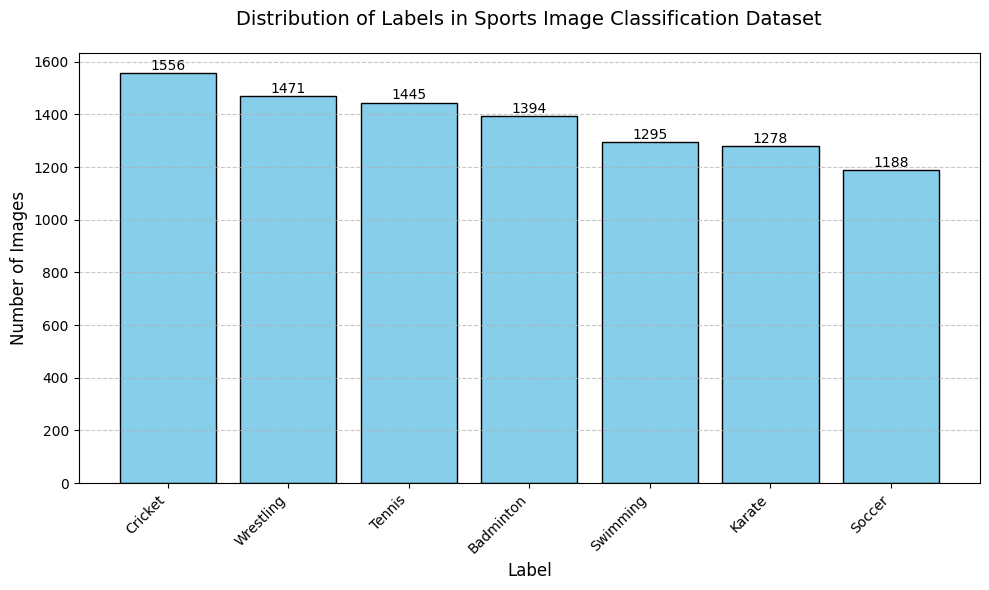

In [ ]:

csv_path = '/content/dataset/train.csv'

# 1. Check if CSV file exists
if not os.path.exists(csv_path):
    print(f"Error: The file {csv_path} does not exist.")
    print("Please ensure the dataset is uploaded or mounted correctly.")
    print("Example: Upload dataset zip and unzip with '!unzip /content/your_dataset.zip -d /content/'")
    print("Or mount Google Drive: 'from google.colab import drive; drive.mount('/content/drive')'")
else:
    # 2. Load CSV and extract labels
    print("Loading CSV file...")
    try:
        df = pd.read_csv(csv_path)
        if 'label' not in df.columns:
            print("Error: 'label' column not found in CSV. Please check column names.")
        else:
            label_counts = df['label'].value_counts()
            print(f"Found {len(label_counts)} unique labels:")
            print(label_counts)

            # 3. Create bar chart
            plt.figure(figsize=(10, 6))
            bars = plt.bar(label_counts.index, label_counts.values, color='skyblue', edgecolor='black')

            # Customize chart
            plt.title('Distribution of Labels in Sports Image Classification Dataset', fontsize=14, pad=20)
            plt.xlabel('Label', fontsize=12)
            plt.ylabel('Number of Images', fontsize=12)
            plt.xticks(rotation=45, ha='right', fontsize=10)
            plt.grid(axis='y', linestyle='--', alpha=0.7)

            # Add value labels on top of bars
            for bar in bars:
                yval = bar.get_height()
                plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, yval, ha='center', va='bottom', fontsize=10)

            # Adjust layout to prevent label cutoff
            plt.tight_layout()

            # 4. Save the plot
            output_path = '/content/label_distribution.png'
            plt.savefig(output_path, dpi=300, bbox_inches='tight')
            print(f"Bar chart saved as {output_path}")

            # Display in Colab
            plt.show()

    except Exception as e:
        print(f"Error processing CSV: {e}")

In [ ]:
import pandas as pd
import json
import os

input_dir = '/content/dataset'
current_dir = "/content/dataset"
train_csv_path = os.path.join(input_dir, 'train.csv')
train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
label_mapping_path = os.path.join(current_dir, 'label_mapping.json')

if not os.path.exists(train_csv_path):
    print(f"Error: The file {train_csv_path} does not exist.")
    print("Please ensure the dataset is uploaded or mounted correctly.")
    print("Example: Upload dataset zip and unzip with '!unzip /content/dataset.zip -d /content/'")
    print("Or mount Google Drive: 'from google.colab import drive; drive.mount('/content/drive')'")
else:
    # 2. Load train.csv
    print("Loading train.csv...")
    try:
        df_train = pd.read_csv(train_csv_path)
        if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
            print("Error: 'label' or 'image_ID' column not found in train.csv. Please check column names.")
        else:
            print(f"Loaded train.csv with {len(df_train)} entries.")

            # 3. Create label mapping
            print("\nCreating label mapping from train.csv...")
            unique_labels = sorted(df_train['label'].unique())  # Sort for consistency
            label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
            print("\nLabel Mapping (label: encoded_value):")
            for label, encoded in label_mapping.items():
                print(f"{label}: {encoded}")

            # Save label mapping
            try:
                with open(label_mapping_path, 'w') as f:
                    json.dump(label_mapping, f, indent=4)
                print(f"\nLabel mapping saved as {label_mapping_path}")
            except Exception as e:
                print(f"Error saving label mapping: {e}")

            # 4. Encode train.csv labels
            print("\nEncoding train.csv labels...")
            try:
                df_train['label_encoded'] = df_train['label'].map(label_mapping)
                if df_train['label_encoded'].isna().any():
                    print("Warning: Some labels in train.csv could not be mapped. This should not happen.")
                df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')  # Allow NaN
                df_train_encoded = df_train[['image_ID', 'label_encoded']]

                # Shuffle the DataFrame
                print("\nShuffling the data...")
                df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)

                # Save shuffled DataFrame
                df_train_encoded.to_csv(train_encoded_csv_path, index=False)
                print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")
            except Exception as e:
                print(f"Error encoding or shuffling train.csv: {e}")
    except Exception as e:
        print(f"Error loading train.csv: {e}")

Loading train.csv...
Loaded train.csv with 9627 entries.

Creating label mapping from train.csv...

Label Mapping (label: encoded_value):
Badminton: 0
Cricket: 1
Karate: 2
Soccer: 3
Swimming: 4
Tennis: 5
Wrestling: 6

Label mapping saved as /content/dataset/label_mapping.json

Encoding train.csv labels...

Shuffling the data...
Shuffled and encoded train.csv saved as /content/dataset/train_encoded.csv


Loading images from image_normalized...
Total number of images found: 9048
Processed 9048 valid images.
Histogram saved as /content/pixel_intensity_histogram.png


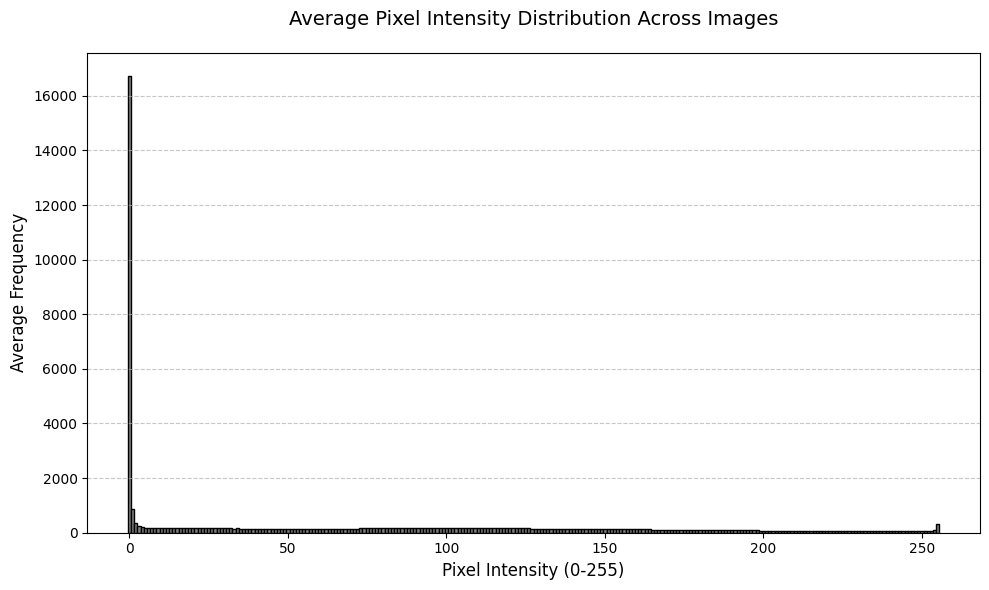

In [ ]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Define the path to the normalized images folder
images_path = '/content/dataset/image_normalized'

# Supported image extensions
image_extensions = ('.jpg', '.jpeg')

# 1. Check if images folder exists
if not os.path.exists(images_path):
    print(f"Error: The folder {images_path} does not exist.")
    print("Please ensure the dataset is correctly set up.")
    print("Check if the folder '/content/dataset/image_normalized' contains the images.")
else:
    # 2. List all image files
    print("Loading images from image_normalized...")
    image_files = [f for f in os.listdir(images_path) if f.lower().endswith(image_extensions)]
    print(f"Total number of images found: {len(image_files)}")

    # 3. Compute pixel intensity histograms
    hist_sum = np.zeros(256)  # Sum of histograms (256 bins for 0-255)
    valid_image_count = 0
    error_files = []

    for img_file in image_files:
        try:
            img_path = os.path.join(images_path, img_file)
            with Image.open(img_path) as img:
                # Convert to RGB if not already
                rgb_img = img.convert('RGB')
                # Convert to numpy array
                img_array = np.array(rgb_img)
                # Compute mean intensity across R, G, B channels
                mean_intensity = img_array.mean(axis=2).astype(np.uint8)
                # Compute histogram (256 bins, 0-255)
                hist, _ = np.histogram(mean_intensity, bins=256, range=(0, 256), density=False)
                hist_sum += hist
                valid_image_count += 1
        except Exception as e:
            error_files.append((img_file, str(e)))

    if valid_image_count == 0:
        print("Error: No valid images processed.")
    else:
        # Compute average histogram
        avg_hist = hist_sum / valid_image_count
        print(f"Processed {valid_image_count} valid images.")
        if error_files:
            print(f"Errors processing {len(error_files)} files:")
            for img_file, error in error_files:
                print(f"- {img_file}: {error}")

        # 4. Create histogram visualization
        plt.figure(figsize=(10, 6))
        plt.bar(range(256), avg_hist, color='gray', edgecolor='black', width=1.0)

        # Customize chart
        plt.title('Average Pixel Intensity Distribution Across Images', fontsize=14, pad=20)
        plt.xlabel('Pixel Intensity (0-255)', fontsize=12)
        plt.ylabel('Average Frequency', fontsize=12)
        plt.grid(axis='y', linestyle='--', alpha=0.7)

        # Adjust layout
        plt.tight_layout()

        # 5. Save the plot
        output_path = '/content/pixel_intensity_histogram.png'  # Updated path for Colab
        plt.savefig(output_path, dpi=300, bbox_inches='tight')
        print(f"Histogram saved as {output_path}")
        plt.show()

#Training


In [ ]:

import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras.callbacks import LearningRateScheduler, TensorBoard
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
import datetime




In [ ]:
import pandas as pd
import json
import os
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.callbacks import TensorBoard, EarlyStopping, LearningRateScheduler
import matplotlib.pyplot as plt
from datetime import datetime

# Hyperparameter settings to explore
hyperparam_settings = {
    "batch_sizes": [32, 64, 128],
    "num_conv_layers": [2, 3, 4],
    "dropout_rates": [0.2, 0.3, 0.5],
    "optimizers": ["adam", "sgd", "rmsprop"],
    "l2_lambdas": [0.0, 0.001, 0.01],
    "learning_rates": [0.001, 0.0001]
}


default_hyperparams = {
    "batch_size": 32,
    "num_conv_layers": 3,
    "dropout_rate": 0.3,
    "optimizer": "adam",
    "l2_lambda": 0.001,
    "learning_rate": 0.001
}

# Paths
input_dir = '/content/dataset'
current_dir = "/content/dataset"
train_csv_path = os.path.join(input_dir, 'train.csv')
train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
image_dir = '/content/dataset/image_normalized'
log_dir = os.path.join(current_dir, "logs", datetime.now().strftime("%Y%m%d-%H%M%S"))

# Function to load and preprocess images
def load_and_preprocess_image(image_id, label):
    try:
        image_id = tf.strings.split(image_id, '/')[-1]
        img_path = tf.strings.join([image_dir, '/', image_id])
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])
        img = img / 255.0
        return img, label
    except tf.errors.InvalidArgumentError as e:
        print(f"Error loading image {image_id}: {e}")
        return tf.zeros([224, 224, 3], dtype=tf.float32), label

# Learning rate scheduler (exponential decay)
def lr_scheduler(epoch, lr):
    initial_lr = default_hyperparams["learning_rate"]
    decay_rate = 0.96
    decay_steps = 5
    return initial_lr * (decay_rate ** (epoch // decay_steps))

# Function to build CNN model with variable number of convolutional layers
def build_model(num_conv_layers, dropout_rate, l2_lambda, num_classes):
    model = Sequential()

    # Convolutional layers
    if num_conv_layers >= 1:
        model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3),
                         kernel_regularizer=l2(l2_lambda)))
        model.add(MaxPooling2D((2, 2)))
    if num_conv_layers >= 2:
        model.add(Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(l2_lambda)))
        model.add(MaxPooling2D((2, 2)))
    if num_conv_layers >= 3:
        model.add(Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(l2_lambda)))
        model.add(MaxPooling2D((2, 2)))
    if num_conv_layers >= 4:
        model.add(Conv2D(256, (3, 3), activation='relu', kernel_regularizer=l2(l2_lambda)))
        model.add(MaxPooling2D((2, 2)))

    # Dense layers
    model.add(Flatten())
    model.add(Dense(128, activation='relu', kernel_regularizer=l2(l2_lambda)))
    model.add(Dropout(dropout_rate))
    model.add(Dense(64, activation='relu', kernel_regularizer=l2(l2_lambda)))
    model.add(Dropout(dropout_rate))
    model.add(Dense(32, activation='relu', kernel_regularizer=l2(l2_lambda)))
    model.add(Dropout(dropout_rate))
    model.add(Dense(num_classes, activation='softmax'))

    return model

# Function to plot and save training history
def plot_training_history(history, run_name):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs_range = range(len(acc))

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.title(f'Training and Validation Accuracy ({run_name})')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.title(f'Training and Validation Loss ({run_name})')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.savefig(os.path.join(current_dir, f'training_plot_{run_name}.png'))
    plt.close()

# Training function
def train_model(train_dataset, val_dataset, num_classes, hyperparams, run_name):
    # Extract hyperparameters
    batch_size = hyperparams["batch_size"]
    num_conv_layers = hyperparams["num_conv_layers"]
    dropout_rate = hyperparams["dropout_rate"]
    optimizer_name = hyperparams["optimizer"]
    l2_lambda = hyperparams["l2_lambda"]
    learning_rate = hyperparams["learning_rate"]

    # Batch datasets
    batched_train_dataset = train_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    batched_val_dataset = val_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

    # Build model
    print(f"Building CNN model with {num_conv_layers} conv layers...")
    model = build_model(num_conv_layers, dropout_rate, l2_lambda, num_classes)

    # Select optimizer
    if optimizer_name == "adam":
        optimizer = Adam(learning_rate=learning_rate)
    elif optimizer_name == "sgd":
        optimizer = SGD(learning_rate=learning_rate, momentum=0.9)
    elif optimizer_name == "rmsprop":
        optimizer = RMSprop(learning_rate=learning_rate)
    else:
        raise ValueError(f"Unsupported optimizer: {optimizer_name}")

    # Compile model
    model.compile(optimizer=optimizer,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    model.summary()

    # Callbacks
    tensorboard_callback = TensorBoard(log_dir=os.path.join(log_dir, run_name), histogram_freq=1)
    early_stopping_callback = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)
    lr_scheduler_callback = LearningRateScheduler(lr_scheduler)

    # Train model
    print(f"\nTraining model for {run_name}...")
    history = model.fit(
        batched_train_dataset,
        validation_data=batched_val_dataset,
        epochs=20,
        callbacks=[tensorboard_callback, early_stopping_callback, lr_scheduler_callback],
        verbose=1
    )

    # Save model
    model_save_path = os.path.join(current_dir, f'trained_model_{run_name}.keras')
    model.save(model_save_path)
    print(f"\nModel saved to {model_save_path}")

    # Print final metrics
    print(f"\nTraining complete for {run_name}. Final metrics:")
    print(f"Training accuracy: {history.history['accuracy'][-1]:.4f}")
    print(f"Validation accuracy: {history.history['val_accuracy'][-1]:.4f}")

    # Plot and save training history
    plot_training_history(history, run_name)

    return history

# Main processing
if not os.path.exists(train_csv_path):
    print(f"Error: The file {train_csv_path} does not exist.")
    print("Please ensure the dataset is uploaded or mounted correctly.")
else:
    print("Loading train.csv...")
    try:
        df_train = pd.read_csv(train_csv_path)
        if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
            print("Error: 'label' or 'image_ID' column not found in train.csv.")
            raise ValueError("Invalid columns in train.csv")

        print(f"Loaded train.csv with {len(df_train)} entries.")

        print("\nCreating label mapping from train.csv...")
        unique_labels = sorted(df_train['label'].unique())
        label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
        print("\nLabel Mapping (label: encoded_value):")
        for label, encoded in label_mapping.items():
            print(f"{label}: {encoded}")

        try:
            with open(label_mapping_path, 'w') as f:
                json.dump(label_mapping, f, indent=4)
            print(f"\nLabel mapping saved as {label_mapping_path}")
        except Exception as e:
            print(f"Error saving label mapping: {e}")
            raise

        print("\nEncoding train.csv labels...")
        df_train['label_encoded'] = df_train['label'].map(label_mapping)
        if df_train['label_encoded'].isna().any():
            print("Warning: Some labels could not be mapped.")
        df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')
        df_train_encoded = df_train[['image_ID', 'label_encoded']]

        print("\nShuffling the data...")
        df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)
        df_train_encoded.to_csv(train_encoded_csv_path, index=False)
        print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")

        print("\nStarting training phase...")
        try:
            with open(label_mapping_path, 'r') as f:
                label_mapping = json.load(f)
            num_classes = len(label_mapping)
        except Exception as e:
            print(f"Error loading label mapping: {e}")
            raise

        df_encoded = pd.read_csv(train_encoded_csv_path)
        if 'image_ID' not in df_encoded.columns or 'label_encoded' not in df_encoded.columns:
            print("Error: 'image_ID' or 'label_encoded' column not found.")
            raise ValueError("Invalid columns in train_encoded.csv")

        print("\nChecking for missing images...")
        valid_rows = []
        missing_images = []
        for idx, row in df_encoded.iterrows():
            image_id = row['image_ID'].split('/')[-1]
            image_path = os.path.join(image_dir, image_id)
            if os.path.exists(image_path):
                valid_rows.append(row)
            else:
                missing_images.append(row['image_ID'])
        if missing_images:
            print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
            df_encoded = pd.DataFrame(valid_rows).reset_index(drop=True)
            print(f"Filtered dataset to {len(df_encoded)} valid entries.")
        else:
            print("All images found.")

        if len(df_encoded) == 0:
            raise ValueError("No valid images found after filtering.")

        train_size = int(0.8 * len(df_encoded))
        train_df = df_encoded[:train_size]
        val_df = df_encoded[train_size:]

        print("Creating TensorFlow datasets...")
        train_dataset = tf.data.Dataset.from_tensor_slices(
            (train_df['image_ID'].values, train_df['label_encoded'].values)
        )
        val_dataset = tf.data.Dataset.from_tensor_slices(
            (val_df['image_ID'].values, val_df['label_encoded'].values)
        )

        train_dataset = train_dataset.map(
            load_and_preprocess_image,
            num_parallel_calls=tf.data.AUTOTUNE
        ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))
        val_dataset = val_dataset.map(
            load_and_preprocess_image,
            num_parallel_calls=tf.data.AUTOTUNE
        ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))

        # Test each hyperparameter independently
        for hyperparam_name, values in hyperparam_settings.items():
            print(f"\n=== Testing hyperparameter: {hyperparam_name} ===")
            for value in values:
                # Create a copy of default hyperparameters
                current_hyperparams = default_hyperparams.copy()

                # Update the hyperparameter being tested
                if hyperparam_name == "batch_sizes":
                    current_hyperparams["batch_size"] = value
                elif hyperparam_name == "num_conv_layers":
                    current_hyperparams["num_conv_layers"] = value
                elif hyperparam_name == "dropout_rates":
                    current_hyperparams["dropout_rate"] = value
                elif hyperparam_name == "optimizers":
                    current_hyperparams["optimizer"] = value
                elif hyperparam_name == "l2_lambdas":
                    current_hyperparams["l2_lambda"] = value
                elif hyperparam_name == "learning_rates":
                    current_hyperparams["learning_rate"] = value

                # Generate a unique run name
                run_name = f"{hyperparam_name}_{value}".replace(".", "_")

                # Train the model
                train_model(train_dataset, val_dataset, num_classes, current_hyperparams, run_name)

    except Exception as e:
        print(f"Error in processing: {e}")

Loading train.csv...
Loaded train.csv with 9627 entries.

Creating label mapping from train.csv...

Label Mapping (label: encoded_value):
Badminton: 0
Cricket: 1
Karate: 2
Soccer: 3
Swimming: 4
Tennis: 5
Wrestling: 6

Label mapping saved as /content/dataset/label_mapping.json

Encoding train.csv labels...

Shuffling the data...
Shuffled and encoded train.csv saved as /content/dataset/train_encoded.csv

Starting training phase...

Checking for missing images...
Filtered dataset to 9625 valid entries.
Creating TensorFlow datasets...

=== Testing hyperparameter: batch_sizes ===
Building CNN model with 3 conv layers...


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for batch_sizes_32...
Epoch 1/20
    241/Unknown 19s 60ms/step - accuracy: 0.1644 - loss: 2.2439

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/epoch_iterator.py:151: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


241/241 ━━━━━━━━━━━━━━━━━━━━ 25s 86ms/step - accuracy: 0.1647 - loss: 2.2432 - val_accuracy: 0.3138 - val_loss: 1.9369 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 76ms/step - accuracy: 0.3682 - loss: 1.7900 - val_accuracy: 0.4665 - val_loss: 1.5568 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 74ms/step - accuracy: 0.4743 - loss: 1.5693 - val_accuracy: 0.5564 - val_loss: 1.3784 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.5542 - loss: 1.4236 - val_accuracy: 0.6296 - val_loss: 1.2668 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 82ms/step - accuracy: 0.6011 - loss: 1.3361 - val_accuracy: 0.6400 - val_loss: 1.2648 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.6346 - loss: 1.2514 - val_accuracy: 0.6364 - val_loss: 1.2796 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 21s 70ms/step - accuracy: 0.6603 - loss: 1.

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for batch_sizes_64...
Epoch 1/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 34s 182ms/step - accuracy: 0.1892 - loss: 2.3499 - val_accuracy: 0.3460 - val_loss: 1.9401 - learning_rate: 0.0010
Epoch 2/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 16s 136ms/step - accuracy: 0.3641 - loss: 1.8286 - val_accuracy: 0.5226 - val_loss: 1.5430 - learning_rate: 0.0010
Epoch 3/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 20s 132ms/step - accuracy: 0.4824 - loss: 1.5872 - val_accuracy: 0.6125 - val_loss: 1.3788 - learning_rate: 0.0010
Epoch 4/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 16s 134ms/step - accuracy: 0.5591 - loss: 1.4459 - val_accuracy: 0.6353 - val_loss: 1.2861 - learning_rate: 0.0010
Epoch 5/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 16s 135ms/step - accuracy: 0.6146 - loss: 1.3322 - val_accuracy: 0.6436 - val_loss: 1.3390 - learning_rate: 0.0010
Epoch 6/20
121/121 ━━━━━━━━━━━━━━━━━━━━ 22s 146ms/step - accuracy: 0.6528 - loss: 1.2632 - val_accuracy: 0.6597 - val_loss: 1.3367 - learning_rate: 9.6000e-04
Epoch 7/20
121/121 ━━━━━━━━━

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_9 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for batch_sizes_128...
Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 43s 406ms/step - accuracy: 0.2114 - loss: 2.2946 - val_accuracy: 0.3330 - val_loss: 1.9060 - learning_rate: 0.0010
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 35s 576ms/step - accuracy: 0.3838 - loss: 1.8249 - val_accuracy: 0.5065 - val_loss: 1.5856 - learning_rate: 0.0010
Epoch 3/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 22s 257ms/step - accuracy: 0.4716 - loss: 1.6272 - val_accuracy: 0.5761 - val_loss: 1.4625 - learning_rate: 0.0010
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 16s 260ms/step - accuracy: 0.5393 - loss: 1.4977 - val_accuracy: 0.5517 - val_loss: 1.6229 - learning_rate: 0.0010
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 17s 272ms/step - accuracy: 0.5814 - loss: 1.4250 - val_accuracy: 0.6665 - val_loss: 1.2552 - learning_rate: 0.0010
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 20s 322ms/step - accuracy: 0.6494 - loss: 1.2917 - val_accuracy: 0.6592 - val_loss: 1.2784 - learning_rate: 9.6000e-04
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 1

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 186624)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 128)            │    23,888,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,917,959 (91.24 MB)

 Trainable params: 23,917,959 (91.24 MB)

 Non-trainable params: 0 (0.00 B)


Training model for num_conv_layers_2...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 30s 98ms/step - accuracy: 0.2260 - loss: 2.4643 - val_accuracy: 0.3387 - val_loss: 2.0337 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.3759 - loss: 2.0111 - val_accuracy: 0.5439 - val_loss: 1.7395 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 80ms/step - accuracy: 0.5383 - loss: 1.7592 - val_accuracy: 0.6312 - val_loss: 1.6065 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.6127 - loss: 1.6628 - val_accuracy: 0.6281 - val_loss: 1.6458 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 77ms/step - accuracy: 0.6588 - loss: 1.6160 - val_accuracy: 0.6473 - val_loss: 1.6379 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 21s 87ms/step - accuracy: 0.7167 - loss: 1.5121 - val_accuracy: 0.7065 - val_loss: 1.5856 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_14 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_16 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_17 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for num_conv_layers_3...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 88ms/step - accuracy: 0.2143 - loss: 2.2330 - val_accuracy: 0.3709 - val_loss: 1.8062 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3870 - loss: 1.8147 - val_accuracy: 0.5132 - val_loss: 1.5824 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 22s 90ms/step - accuracy: 0.4800 - loss: 1.6318 - val_accuracy: 0.5860 - val_loss: 1.4231 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.5666 - loss: 1.4604 - val_accuracy: 0.6005 - val_loss: 1.3674 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.6254 - loss: 1.3427 - val_accuracy: 0.6478 - val_loss: 1.3819 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.6849 - loss: 1.2341 - val_accuracy: 0.6795 - val_loss: 1.2960 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_17 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_20 (Conv2D)              │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 12, 12, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 36864)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 128)            │     4,718,720 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_18 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_19 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_20 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,117,703 (19.52 MB)

 Trainable params: 5,117,703 (19.52 MB)

 Non-trainable params: 0 (0.00 B)


Training model for num_conv_layers_4...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 29s 90ms/step - accuracy: 0.1525 - loss: 2.2412 - val_accuracy: 0.2203 - val_loss: 1.9728 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 71ms/step - accuracy: 0.2170 - loss: 1.9195 - val_accuracy: 0.3190 - val_loss: 1.7559 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 67ms/step - accuracy: 0.2972 - loss: 1.7849 - val_accuracy: 0.3605 - val_loss: 1.7014 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 67ms/step - accuracy: 0.3522 - loss: 1.6986 - val_accuracy: 0.4005 - val_loss: 1.6109 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.3735 - loss: 1.6553 - val_accuracy: 0.4125 - val_loss: 1.6367 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 72ms/step - accuracy: 0.4159 - loss: 1.5894 - val_accuracy: 0.4436 - val_loss: 1.5402 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_21 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for dropout_rates_0_2...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 27s 89ms/step - accuracy: 0.2376 - loss: 2.2085 - val_accuracy: 0.4192 - val_loss: 1.8137 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.4594 - loss: 1.6727 - val_accuracy: 0.5273 - val_loss: 1.4827 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 72ms/step - accuracy: 0.5707 - loss: 1.4292 - val_accuracy: 0.6447 - val_loss: 1.2696 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 69ms/step - accuracy: 0.6431 - loss: 1.2832 - val_accuracy: 0.6790 - val_loss: 1.2262 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.7011 - loss: 1.1770 - val_accuracy: 0.7262 - val_loss: 1.1370 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.7405 - loss: 1.0858 - val_accuracy: 0.7252 - val_loss: 1.1357 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for dropout_rates_0_3...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 25s 83ms/step - accuracy: 0.1778 - loss: 2.2766 - val_accuracy: 0.3283 - val_loss: 1.8954 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.3712 - loss: 1.7704 - val_accuracy: 0.4758 - val_loss: 1.5523 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 84ms/step - accuracy: 0.4381 - loss: 1.6199 - val_accuracy: 0.5195 - val_loss: 1.4969 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 67ms/step - accuracy: 0.5083 - loss: 1.5143 - val_accuracy: 0.5782 - val_loss: 1.3802 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.5769 - loss: 1.4242 - val_accuracy: 0.6218 - val_loss: 1.3325 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 41s 157ms/step - accuracy: 0.6288 - loss: 1.3184 - val_accuracy: 0.6545 - val_loss: 1.2709 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_27 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for dropout_rates_0_5...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 84ms/step - accuracy: 0.1491 - loss: 2.3419 - val_accuracy: 0.1683 - val_loss: 2.0560 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.1547 - loss: 2.0424 - val_accuracy: 0.1683 - val_loss: 2.0099 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 68ms/step - accuracy: 0.1584 - loss: 2.0056 - val_accuracy: 0.1683 - val_loss: 1.9876 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.1567 - loss: 1.9861 - val_accuracy: 0.1683 - val_loss: 1.9731 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.1566 - loss: 1.9725 - val_accuracy: 0.1683 - val_loss: 1.9635 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 68ms/step - accuracy: 0.1564 - loss: 1.9640 - val_accuracy: 0.1683 - val_loss: 1.9570 - learning_rate: 9.6000e-04

Model saved to /content/datase

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_30 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_30 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_31 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for optimizers_adam...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 88ms/step - accuracy: 0.1661 - loss: 2.3551 - val_accuracy: 0.2842 - val_loss: 1.8974 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.3156 - loss: 1.8891 - val_accuracy: 0.4161 - val_loss: 1.7035 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 72ms/step - accuracy: 0.4105 - loss: 1.6977 - val_accuracy: 0.5808 - val_loss: 1.4456 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 69ms/step - accuracy: 0.5296 - loss: 1.4968 - val_accuracy: 0.6426 - val_loss: 1.2806 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.5953 - loss: 1.3537 - val_accuracy: 0.6670 - val_loss: 1.2566 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.6467 - loss: 1.2576 - val_accuracy: 0.6774 - val_loss: 1.2497 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━━

Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_33 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_33 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_34 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_35 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for optimizers_sgd...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 25s 86ms/step - accuracy: 0.1638 - loss: 2.4519 - val_accuracy: 0.3101 - val_loss: 2.3430 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.2497 - loss: 2.3504 - val_accuracy: 0.3158 - val_loss: 2.2321 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 72ms/step - accuracy: 0.3033 - loss: 2.2699 - val_accuracy: 0.3647 - val_loss: 2.1368 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 73ms/step - accuracy: 0.3391 - loss: 2.1946 - val_accuracy: 0.4374 - val_loss: 2.0507 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3840 - loss: 2.1004 - val_accuracy: 0.4660 - val_loss: 1.9729 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.4111 - loss: 2.0397 - val_accuracy: 0.5216 - val_loss: 1.8712 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━━━

Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_36 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_37 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_38 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for optimizers_rmsprop...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 87ms/step - accuracy: 0.1924 - loss: 2.3599 - val_accuracy: 0.4327 - val_loss: 1.7125 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.3977 - loss: 1.7283 - val_accuracy: 0.4842 - val_loss: 1.5422 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 71ms/step - accuracy: 0.5087 - loss: 1.5027 - val_accuracy: 0.5927 - val_loss: 1.3604 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 20s 68ms/step - accuracy: 0.5791 - loss: 1.4036 - val_accuracy: 0.4504 - val_loss: 2.1060 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.6274 - loss: 1.3255 - val_accuracy: 0.5605 - val_loss: 1.5797 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.6598 - loss: 1.2375 - val_accuracy: 0.6286 - val_loss: 1.3483 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_39 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_40 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_39 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_40 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for l2_lambdas_0_0...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 85ms/step - accuracy: 0.1864 - loss: 1.9235 - val_accuracy: 0.2956 - val_loss: 1.7243 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 76ms/step - accuracy: 0.3716 - loss: 1.6355 - val_accuracy: 0.5169 - val_loss: 1.3688 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.5168 - loss: 1.3106 - val_accuracy: 0.6395 - val_loss: 1.0454 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.6464 - loss: 1.0337 - val_accuracy: 0.6810 - val_loss: 0.9132 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 21s 87ms/step - accuracy: 0.7214 - loss: 0.8113 - val_accuracy: 0.7283 - val_loss: 0.8208 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.8048 - loss: 0.6284 - val_accuracy: 0.7600 - val_loss: 0.7987 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━━━

Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_42 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_42 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_43 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_44 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for l2_lambdas_0_001...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 25s 84ms/step - accuracy: 0.1754 - loss: 2.3464 - val_accuracy: 0.2722 - val_loss: 1.9702 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 35s 68ms/step - accuracy: 0.2629 - loss: 1.9656 - val_accuracy: 0.3896 - val_loss: 1.7562 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 68ms/step - accuracy: 0.3606 - loss: 1.7985 - val_accuracy: 0.4395 - val_loss: 1.6396 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 74ms/step - accuracy: 0.4580 - loss: 1.5849 - val_accuracy: 0.5200 - val_loss: 1.5060 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 68ms/step - accuracy: 0.5195 - loss: 1.4716 - val_accuracy: 0.5912 - val_loss: 1.3532 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.5614 - loss: 1.3989 - val_accuracy: 0.5964 - val_loss: 1.2903 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━

Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_45 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_45 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_46 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_47 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for l2_lambdas_0_01...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 27s 92ms/step - accuracy: 0.1835 - loss: 3.6937 - val_accuracy: 0.3704 - val_loss: 1.9800 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.3391 - loss: 1.9404 - val_accuracy: 0.4197 - val_loss: 1.7260 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3780 - loss: 1.7442 - val_accuracy: 0.4286 - val_loss: 1.6616 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3962 - loss: 1.6962 - val_accuracy: 0.4332 - val_loss: 1.6246 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 42s 158ms/step - accuracy: 0.4154 - loss: 1.6440 - val_accuracy: 0.4255 - val_loss: 1.6135 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.4255 - loss: 1.6211 - val_accuracy: 0.4696 - val_loss: 1.5605 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━━━━━

Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_48 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_49 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_50 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for learning_rates_0_001...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 87ms/step - accuracy: 0.1454 - loss: 2.3097 - val_accuracy: 0.1694 - val_loss: 2.0419 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.2324 - loss: 1.9648 - val_accuracy: 0.3465 - val_loss: 1.7499 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3353 - loss: 1.7847 - val_accuracy: 0.3548 - val_loss: 1.7482 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.3647 - loss: 1.6997 - val_accuracy: 0.3875 - val_loss: 1.6508 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 18s 72ms/step - accuracy: 0.3951 - loss: 1.6230 - val_accuracy: 0.4426 - val_loss: 1.5961 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 19s 80ms/step - accuracy: 0.4288 - loss: 1.5615 - val_accuracy: 0.4239 - val_loss: 1.6990 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━━

Model: "sequential_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_51 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_52 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_51 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_52 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_53 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 7)              │           231 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,179,527 (42.65 MB)

 Trainable params: 11,179,527 (42.65 MB)

 Non-trainable params: 0 (0.00 B)


Training model for learning_rates_0_0001...
Epoch 1/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 26s 88ms/step - accuracy: 0.2097 - loss: 2.3050 - val_accuracy: 0.3803 - val_loss: 1.8526 - learning_rate: 0.0010
Epoch 2/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 69ms/step - accuracy: 0.3540 - loss: 1.8735 - val_accuracy: 0.5013 - val_loss: 1.5672 - learning_rate: 0.0010
Epoch 3/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 16s 68ms/step - accuracy: 0.4794 - loss: 1.6575 - val_accuracy: 0.5865 - val_loss: 1.4427 - learning_rate: 0.0010
Epoch 4/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 72ms/step - accuracy: 0.5846 - loss: 1.4560 - val_accuracy: 0.6213 - val_loss: 1.3970 - learning_rate: 0.0010
Epoch 5/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.6387 - loss: 1.3488 - val_accuracy: 0.6764 - val_loss: 1.2522 - learning_rate: 0.0010
Epoch 6/20
241/241 ━━━━━━━━━━━━━━━━━━━━ 17s 70ms/step - accuracy: 0.6788 - loss: 1.2739 - val_accuracy: 0.7096 - val_loss: 1.1805 - learning_rate: 9.6000e-04
Epoch 7/20
241/241 ━━━━━━━━

Image directory: /content/dataset/test
Directory exists: True
Sample files in image_dir: ['ecdcc0bf7b.jpg', 'd6f9a0b4a0.jpg', '4822600ff3.jpg', 'c5065.jpg', 'b73c8ad49c.jpg']
Loading test.csv...
Loaded test.csv with 2056 entries.
Sample image_IDs: ['f5e13966e7.jpg', '6674191b4e.jpg', '91b5f8b7a9.jpg', '393119b6d6.jpg', '1ce5f81578.jpg']

Label Mapping Loaded:
Badminton: 0
Cricket: 1
Karate: 2
Soccer: 3
Swimming: 4
Tennis: 5
Wrestling: 6

Checking for missing images...
Checking /content/dataset/test/f5e13966e7.jpg: True
Checking /content/dataset/test/6674191b4e.jpg: True
Checking /content/dataset/test/91b5f8b7a9.jpg: True
Checking /content/dataset/test/393119b6d6.jpg: True
Checking /content/dataset/test/1ce5f81578.jpg: True
All images found.

Creating TensorFlow test dataset...

Predicting with model: batch_sizes_32
Loaded model from /content/dataset/trained_model_batch_sizes_32.keras
Generating predictions and displaying images...
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


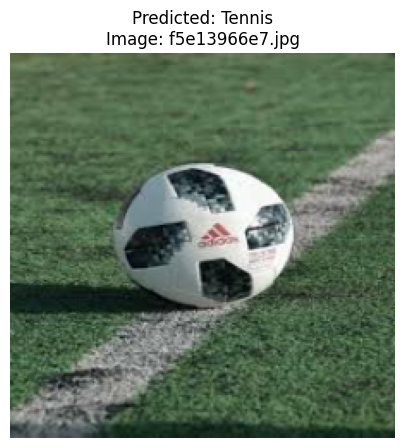

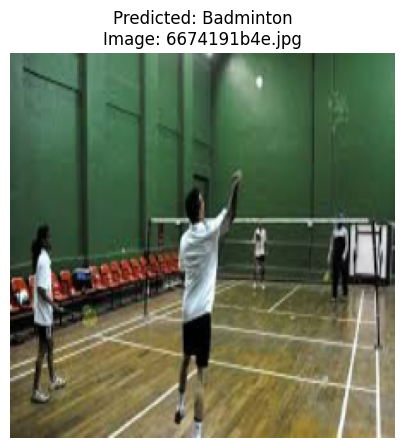

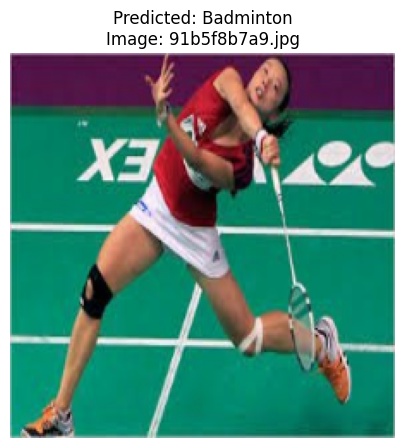

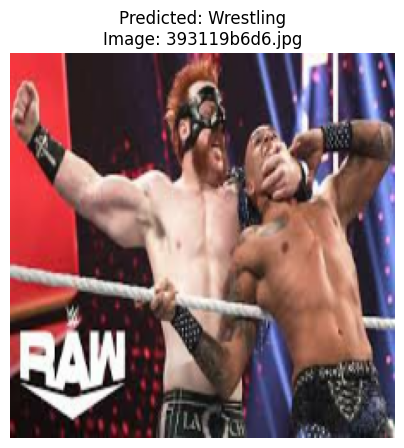

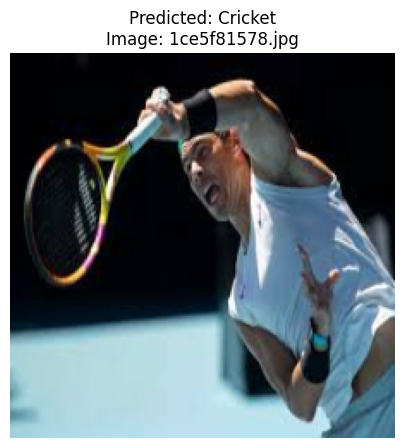

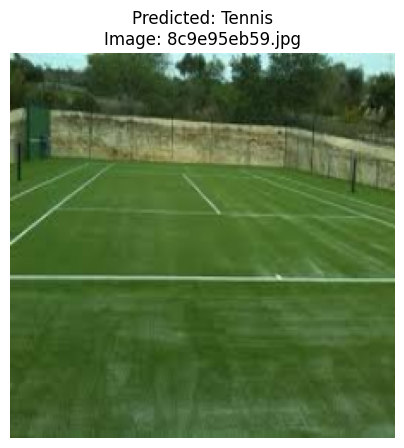

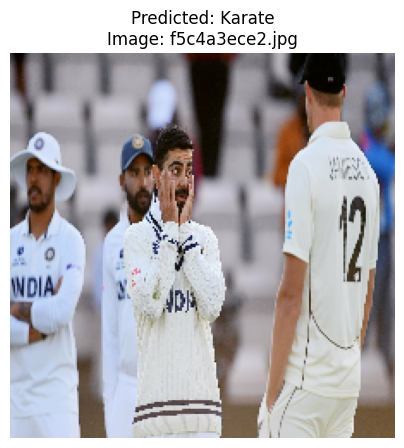

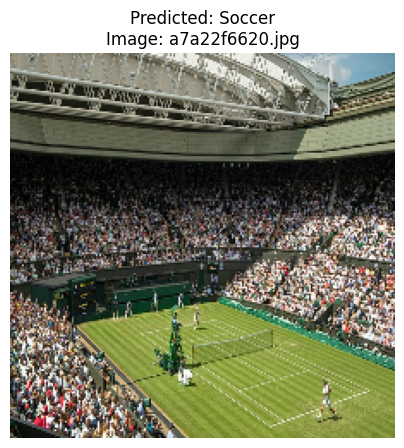

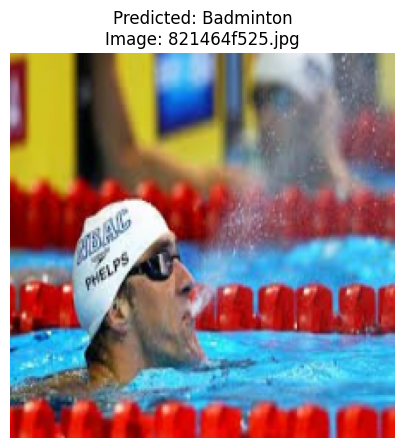

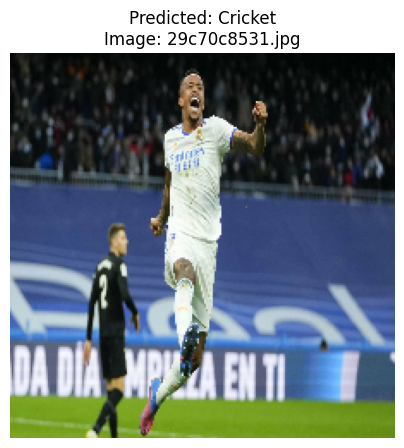

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━

In [ ]:
import pandas as pd
import json
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Paths (adjust as needed)
current_dir = "/content/dataset"
test_csv_path = os.path.join(current_dir, 'test.csv')
label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
image_dir = '/content/dataset/test'  # Update to your test images directory
results_dir = os.path.join(current_dir, "test_results", datetime.now().strftime("%Y%m%d-%H%M%S"))

# Ensure results directory exists
os.makedirs(results_dir, exist_ok=True)

# Number of images to display (adjust as needed)
max_images_to_display = 10  # Set to -1 to display all images

# Debug: Check image_dir
print(f"Image directory: {image_dir}")
print("Directory exists:", os.path.exists(image_dir))
if os.path.exists(image_dir):
    print("Sample files in image_dir:", os.listdir(image_dir)[:5])

# Function to load and preprocess images
def load_and_preprocess_image(image_id):
    try:
        image_id = tf.strings.split(image_id, '/')[-1]
        img_path = tf.strings.join([image_dir, '/', image_id])
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])  # Resize to match training
        img = img / 255.0  # Normalize to [0,1] to match training
        return img, img_path
    except tf.errors.InvalidArgumentError as e:
        print(f"Error loading image {image_id}: {e}")
        return tf.zeros([224, 224, 3], dtype=tf.float32), img_path

# Main prediction function
def predict_models():
    # Check if test.csv exists
    if not os.path.exists(test_csv_path):
        print(f"Error: The file {test_csv_path} does not exist.")
        return

    # Load test.csv
    print("Loading test.csv...")
    try:
        df_test = pd.read_csv(test_csv_path)
        # Check for image_ID column (adjust name if different)
        image_id_col = 'image_ID'  # Update to match your column name, e.g., 'ImageID'
        if image_id_col not in df_test.columns:
            print(f"Error: '{image_id_col}' column not found in test.csv.")
            print("Available columns:", df_test.columns.tolist())
            return
        print(f"Loaded test.csv with {len(df_test)} entries.")
        print("Sample image_IDs:", df_test[image_id_col].head().to_list())
    except Exception as e:
        print(f"Error loading test.csv: {e}")
        return

    # Load label mapping to decode predictions
    try:
        with open(label_mapping_path, 'r') as f:
            label_mapping = json.load(f)
        num_classes = len(label_mapping)
        print("\nLabel Mapping Loaded:")
        for label, encoded in label_mapping.items():
            print(f"{label}: {encoded}")
        # Create reverse mapping for decoding predictions
        reverse_mapping = {v: k for k, v in label_mapping.items()}
    except Exception as e:
        print(f"Error loading label mapping: {e}")
        return

    # Check for missing images
    print("\nChecking for missing images...")
    valid_rows = []
    missing_images = []
    for idx, row in df_test.iterrows():
        image_id = row[image_id_col].split('/')[-1]
        image_path = os.path.join(image_dir, image_id)
        if idx < 5:  # Debug: Print first 5 paths
            print(f"Checking {image_path}: {os.path.exists(image_path)}")
        if os.path.exists(image_path):
            valid_rows.append(row)
        else:
            missing_images.append(row[image_id_col])
    if missing_images:
        print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
        df_test = pd.DataFrame(valid_rows).reset_index(drop=True)
        print(f"Filtered test dataset to {len(df_test)} valid entries.")
    else:
        print("All images found.")

    if len(df_test) == 0:
        print("Error: No valid images found after filtering.")
        return

    # Create TensorFlow dataset (no labels)
    print("\nCreating TensorFlow test dataset...")
    test_dataset = tf.data.Dataset.from_tensor_slices(
        df_test[image_id_col].values
    )
    test_dataset = test_dataset.map(
        load_and_preprocess_image,
        num_parallel_calls=tf.data.AUTOTUNE
    ).filter(lambda x, _: tf.reduce_any(tf.not_equal(x, 0)))
    test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

    # Specify the model file to test
    model_file = "trained_model_batch_sizes_32.keras"  # Replace with your model file
    model_path = os.path.join(current_dir, model_file)

    # Check if the model file exists
    if not os.path.exists(model_path):
        print(f"Error: The model file {model_path} does not exist.")
        return

    # Set run_name for output files
    run_name = model_file.replace('trained_model_', '').replace('.keras', '')
    print(f"\nPredicting with model: {run_name}")

    try:
        # Load model
        model = tf.keras.models.load_model(model_path)
        print(f"Loaded model from {model_path}")

        # Generate predictions and display images
        print("Generating predictions and displaying images...")
        predictions = []
        image_ids = df_test[image_id_col].to_list()
        num_displayed = 0

        # Iterate over dataset to get images and paths
        for batch_images, batch_paths in test_dataset:
            # Predict on batch
            batch_preds = model.predict(batch_images)
            batch_pred_classes = np.argmax(batch_preds, axis=1)
            batch_pred_labels = [reverse_mapping.get(pred, "Unknown") for pred in batch_pred_classes]

            # Process each image in the batch
            for img, path, pred_label in zip(batch_images, batch_paths, batch_pred_labels):
                img_id = path.numpy().decode('utf-8').split('/')[-1]
                predictions.append({'image_ID': img_id, 'predicted_label': pred_label})

                # Display image if within limit
                if max_images_to_display == -1 or num_displayed < max_images_to_display:
                    plt.figure(figsize=(5, 5))
                    plt.imshow(img.numpy())
                    plt.title(f"Predicted: {pred_label}\nImage: {img_id}")
                    plt.axis('off')
                    plt.show()
                    num_displayed += 1

        # Save predictions to CSV
        predictions_df = pd.DataFrame(predictions)
        predictions_path = os.path.join(results_dir, f'predictions_{run_name}.csv')
        predictions_df.to_csv(predictions_path, index=False)
        print(f"Predictions saved to {predictions_path}")

    except Exception as e:
        print(f"Error predicting with model {run_name}: {e}")

    print("\nPrediction complete.")

# Run the prediction
if __name__ == "__main__":
    predict_models()

In [ ]:
import pandas as pd
import json
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Paths (adjust as needed)
current_dir = "/content/dataset"
test_csv_path = os.path.join(current_dir, 'test.csv')
label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
image_dir = '/content/dataset/test'  # Update to your test images directory
results_dir = os.path.join(current_dir, "test_results", datetime.now().strftime("%Y%m%d-%H%M%S"))

# Ensure results directory exists
os.makedirs(results_dir, exist_ok=True)

# Number of images to display (adjust as needed)
max_images_to_display = 10  # Set to -1 to display all images

# Debug: Check image_dir
print(f"Image directory: {image_dir}")
print("Directory exists:", os.path.exists(image_dir))
if os.path.exists(image_dir):
    print("Sample files in image_dir:", os.listdir(image_dir)[:5])

# Function to load and preprocess images
def load_and_preprocess_image(image_id):
    try:
        image_id = tf.strings.split(image_id, '/')[-1]
        img_path = tf.strings.join([image_dir, '/', image_id])
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])  # Resize to match training
        img = img / 255.0  # Normalize to [0,1] to match training
        return img, img_path
    except tf.errors.InvalidArgumentError as e:
        print(f"Error loading image {image_id}: {e}")
        return tf.zeros([224, 224, 3], dtype=tf.float32), img_path

# Main prediction function
def predict_models():
    # Check if test.csv exists
    if not os.path.exists(test_csv_path):
        print(f"Error: The file {test_csv_path} does not exist.")
        return

    # Load test.csv
    print("Loading test.csv...")
    try:
        df_test = pd.read_csv(test_csv_path)
        # Check for image_ID column (adjust name if different)
        image_id_col = 'image_ID'  # Update to match your column name, e.g., 'ImageID'
        if image_id_col not in df_test.columns:
            print(f"Error: '{image_id_col}' column not found in test.csv.")
            print("Available columns:", df_test.columns.tolist())
            return
        print(f"Loaded test.csv with {len(df_test)} entries.")
        print("Sample image_IDs:", df_test[image_id_col].head().to_list())
    except Exception as e:
        print(f"Error loading test.csv: {e}")
        return

    # Load label mapping to decode predictions
    try:
        with open(label_mapping_path, 'r') as f:
            label_mapping = json.load(f)
        num_classes = len(label_mapping)
        print("\nLabel Mapping Loaded:")
        for label, encoded in label_mapping.items():
            print(f"{label}: {encoded}")
        # Create reverse mapping for decoding predictions
        reverse_mapping = {v: k for k, v in label_mapping.items()}
    except Exception as e:
        print(f"Error loading label mapping: {e}")
        return

    # Check for missing images
    print("\nChecking for missing images...")
    valid_rows = []
    missing_images = []
    for idx, row in df_test.iterrows():
        image_id = row[image_id_col].split('/')[-1]
        image_path = os.path.join(image_dir, image_id)
        if idx < 5:  # Debug: Print first 5 paths
            print(f"Checking {image_path}: {os.path.exists(image_path)}")
        if os.path.exists(image_path):
            valid_rows.append(row)
        else:
            missing_images.append(row[image_id_col])
    if missing_images:
        print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
        df_test = pd.DataFrame(valid_rows).reset_index(drop=True)
        print(f"Filtered test dataset to {len(df_test)} valid entries.")
    else:
        print("All images found.")

    if len(df_test) == 0:
        print("Error: No valid images found after filtering.")
        return

    # Create TensorFlow dataset (no labels)
    print("\nCreating TensorFlow test dataset...")
    test_dataset = tf.data.Dataset.from_tensor_slices(
        df_test[image_id_col].values
    )
    test_dataset = test_dataset.map(
        load_and_preprocess_image,
        num_parallel_calls=tf.data.AUTOTUNE
    ).filter(lambda x, _: tf.reduce_any(tf.not_equal(x, 0)))
    test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

    # Specify the model file to test
    model_file = "trained_model_batch_sizes_32.keras"  # Replace with your model file
    model_path = os.path.join(current_dir, model_file)

    # Check if the model file exists
    if not os.path.exists(model_path):
        print(f"Error: The model file {model_path} does not exist.")
        return

    # Set run_name for output files
    run_name = model_file.replace('trained_model_', '').replace('.keras', '')
    print(f"\nPredicting with model: {run_name}")

    try:
        # Load model
        model = tf.keras.models.load_model(model_path)
        print(f"Loaded model from {model_path}")

        # Generate predictions and display images
        print("Generating predictions and displaying images...")
        predictions = []
        image_ids = df_test[image_id_col].to_list()
        num_displayed = 0

        # Iterate over dataset to get images and paths
        for batch_images, batch_paths in test_dataset:
            # Predict on batch
            batch_preds = model.predict(batch_images)
            batch_pred_classes = np.argmax(batch_preds, axis=1)
            batch_pred_labels = [reverse_mapping.get(pred, "Unknown") for pred in batch_pred_classes]

            # Process each image in the batch
            for img, path, pred_label in zip(batch_images, batch_paths, batch_pred_labels):
                img_id = path.numpy().decode('utf-8').split('/')[-1]
                predictions.append({'image_ID': img_id, 'predicted_label': pred_label})

                # Display image if within limit
                if max_images_to_display == -1 or num_displayed < max_images_to_display:
                    plt.figure(figsize=(5, 5))
                    plt.imshow(img.numpy())
                    plt.title(f"Predicted: {pred_label}\nImage: {img_id}")
                    plt.axis('off')
                    plt.show()
                    num_displayed += 1

        # Save predictions to CSV
        predictions_df = pd.DataFrame(predictions)
        predictions_path = os.path.join(results_dir, f'predictions_{run_name}.csv')
        predictions_df.to_csv(predictions_path, index=False)
        print(f"Predictions saved to {predictions_path}")

    except Exception as e:
        print(f"Error predicting with model {run_name}: {e}")

    print("\nPrediction complete.")

# Run the prediction
if __name__ == "__main__":
    predict_models()

Image directory: /content/dataset/test
Directory exists: True
Sample files in image_dir: ['ecdcc0bf7b.jpg', 'd6f9a0b4a0.jpg', '4822600ff3.jpg', 'c5065.jpg', 'b73c8ad49c.jpg']
Loading test.csv...
Loaded test.csv with 2056 entries.
Sample image_IDs: ['f5e13966e7.jpg', '6674191b4e.jpg', '91b5f8b7a9.jpg', '393119b6d6.jpg', '1ce5f81578.jpg']

Label Mapping Loaded:
Badminton: 0
Cricket: 1
Karate: 2
Soccer: 3
Swimming: 4
Tennis: 5
Wrestling: 6

Checking for missing images...
Checking /content/dataset/test/f5e13966e7.jpg: True
Checking /content/dataset/test/6674191b4e.jpg: True
Checking /content/dataset/test/91b5f8b7a9.jpg: True
Checking /content/dataset/test/393119b6d6.jpg: True
Checking /content/dataset/test/1ce5f81578.jpg: True
All images found.

Creating TensorFlow test dataset...

Found models: ['trained_model_batch_sizes_32.keras', 'trained_model_l2_lambdas_0_01.keras', 'trained_model_dropout_rates_0_5.keras', 'trained_model_l2_lambdas_0_001.keras', 'trained_model_batch_sizes_64.keras', 

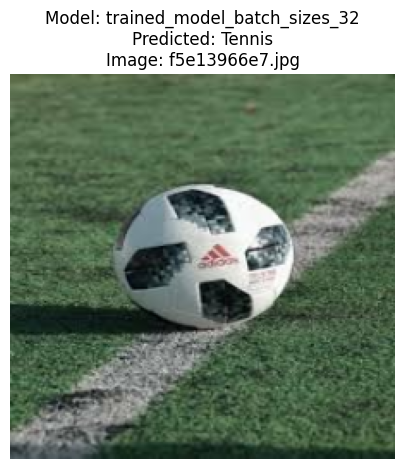

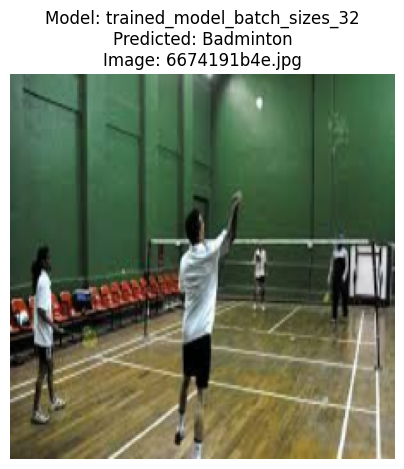

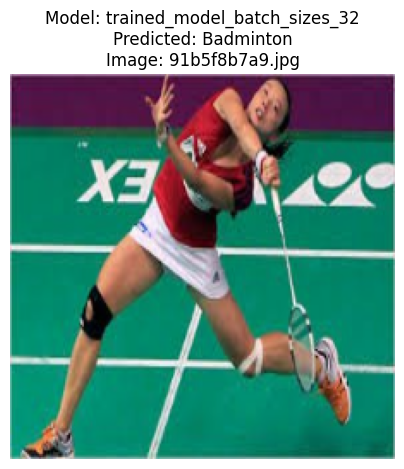

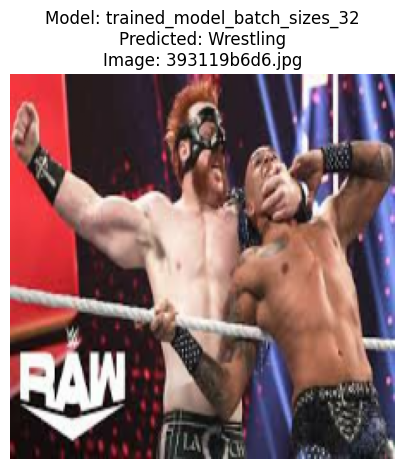

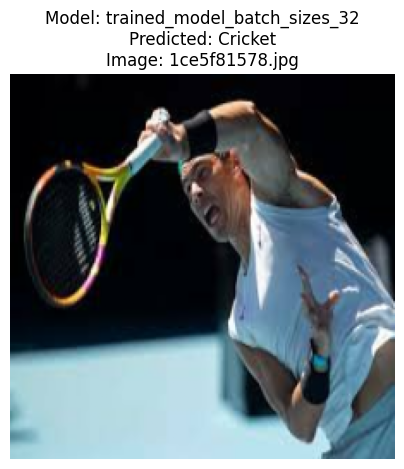

Predictions for trained_model_batch_sizes_32 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_batch_sizes_32.csv

Predicting with model: trained_model_l2_lambdas_0_01
Loaded model from /content/dataset/trained_model_l2_lambdas_0_01.keras
Generating predictions and displaying images...


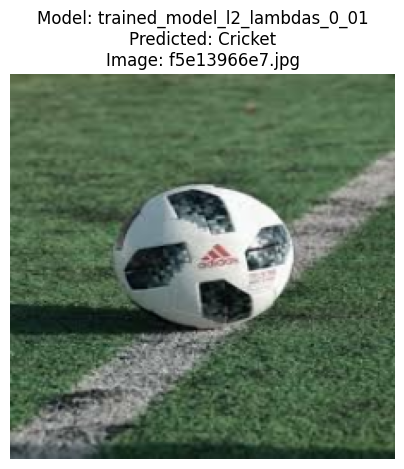

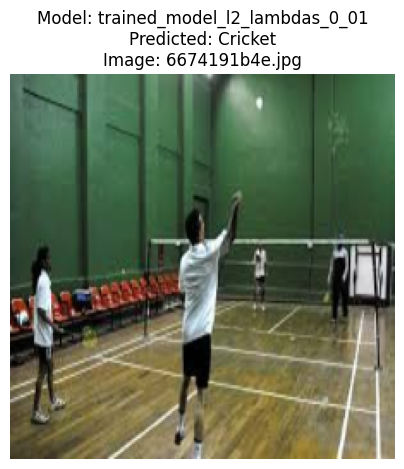

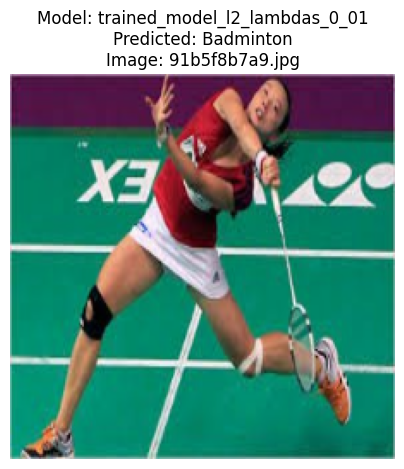

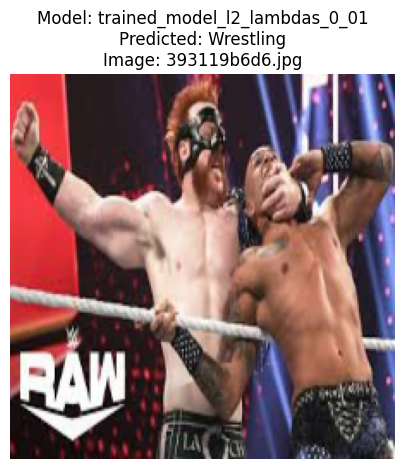

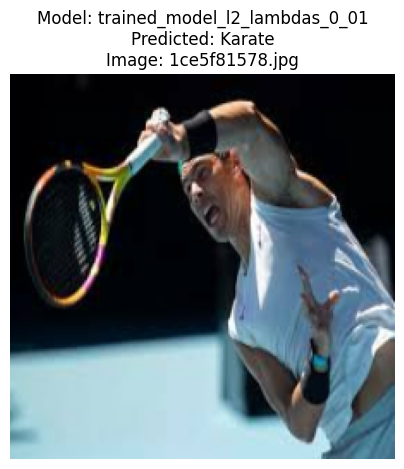

Predictions for trained_model_l2_lambdas_0_01 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_l2_lambdas_0_01.csv

Predicting with model: trained_model_dropout_rates_0_5
Loaded model from /content/dataset/trained_model_dropout_rates_0_5.keras
Generating predictions and displaying images...


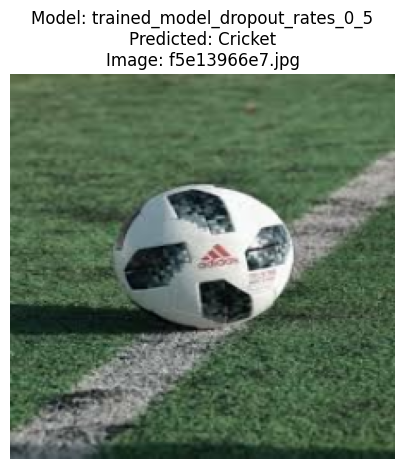

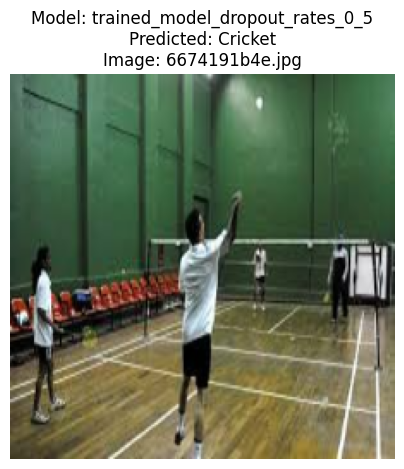

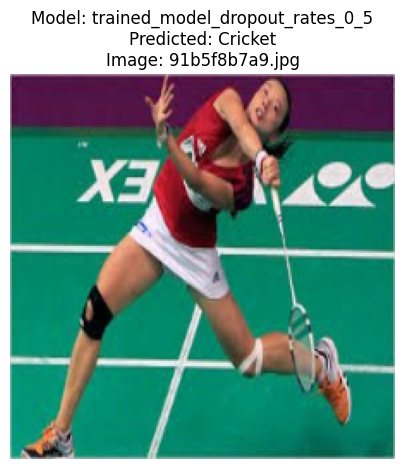

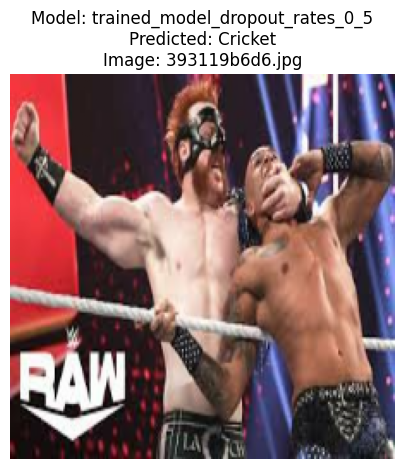

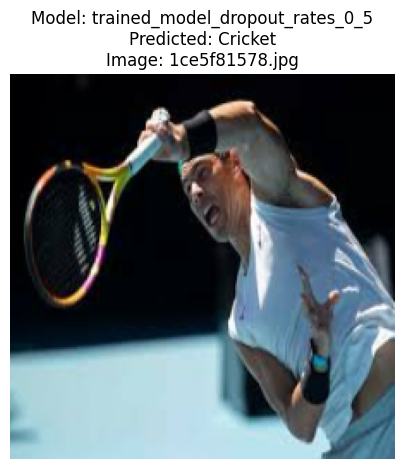

Predictions for trained_model_dropout_rates_0_5 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_dropout_rates_0_5.csv

Predicting with model: trained_model_l2_lambdas_0_001
Loaded model from /content/dataset/trained_model_l2_lambdas_0_001.keras
Generating predictions and displaying images...


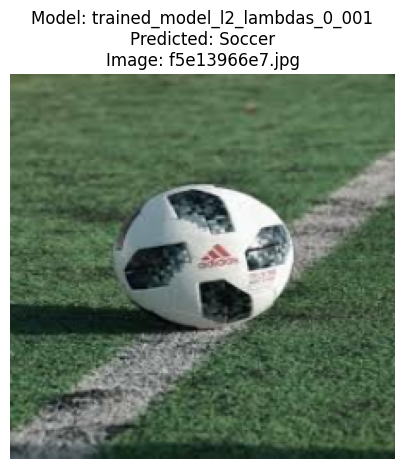

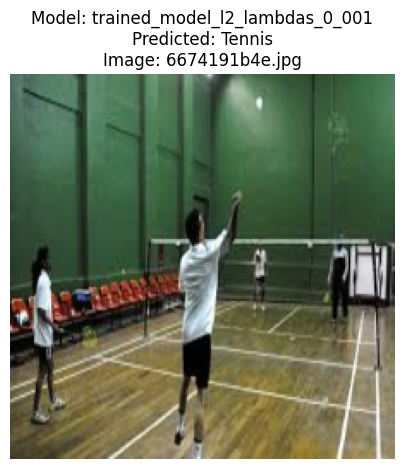

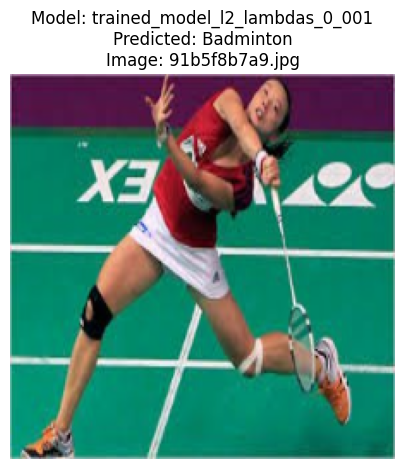

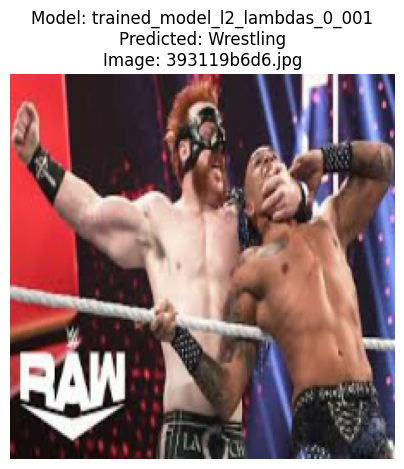

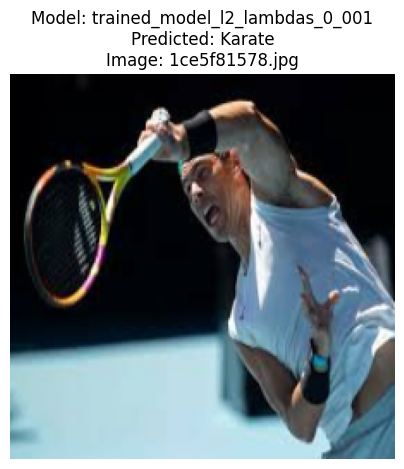

Predictions for trained_model_l2_lambdas_0_001 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_l2_lambdas_0_001.csv

Predicting with model: trained_model_batch_sizes_64
Loaded model from /content/dataset/trained_model_batch_sizes_64.keras
Generating predictions and displaying images...


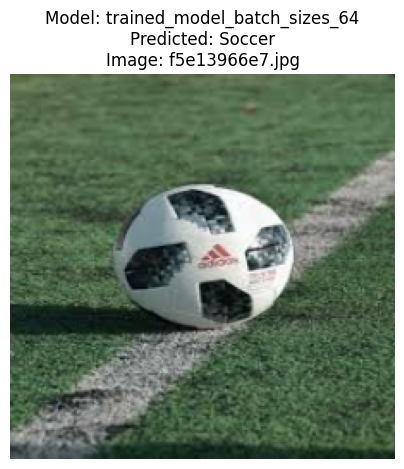

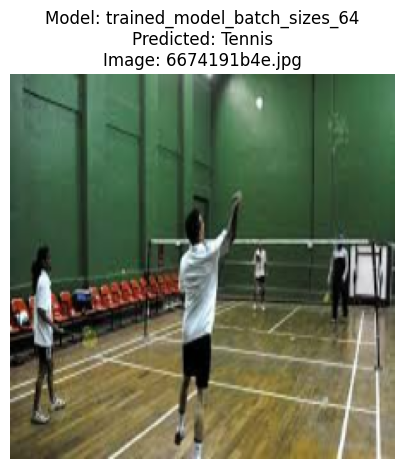

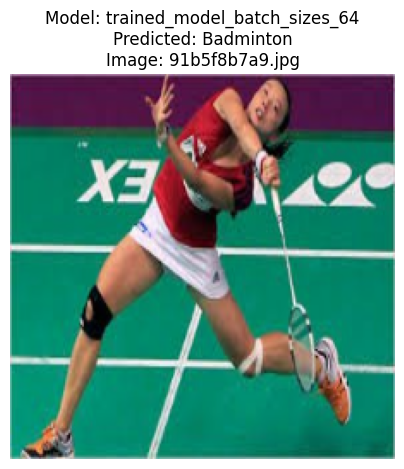

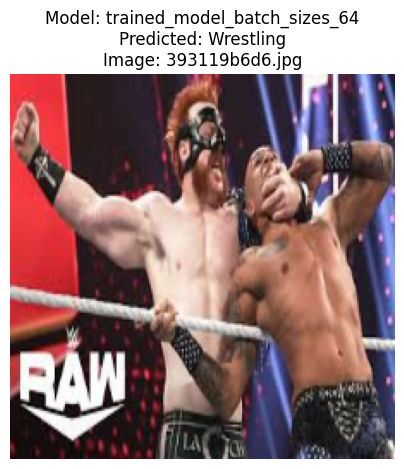

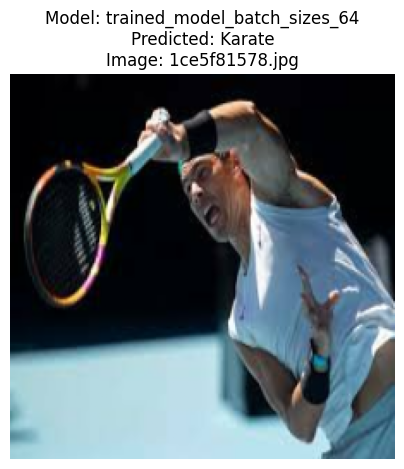

Predictions for trained_model_batch_sizes_64 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_batch_sizes_64.csv

Predicting with model: trained_model_num_conv_layers_3
Loaded model from /content/dataset/trained_model_num_conv_layers_3.keras
Generating predictions and displaying images...


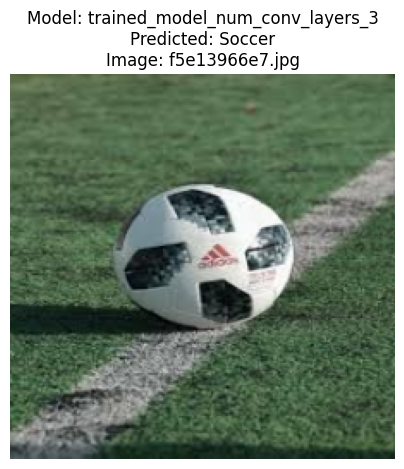

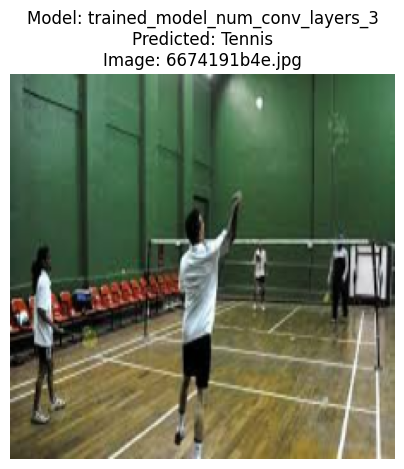

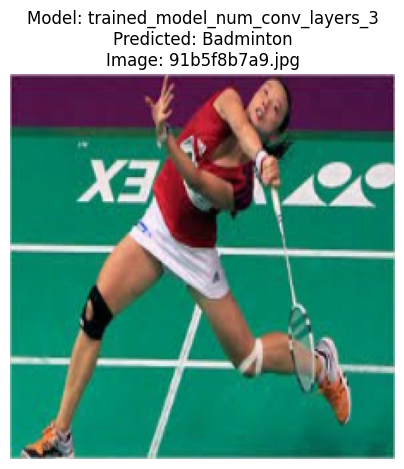

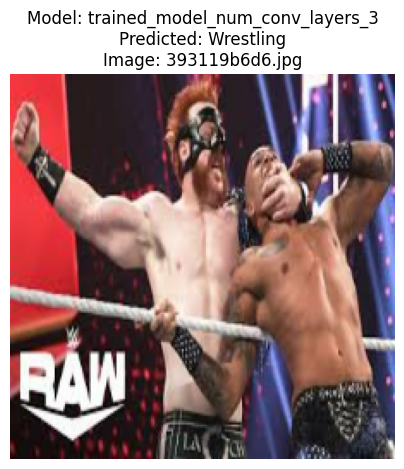

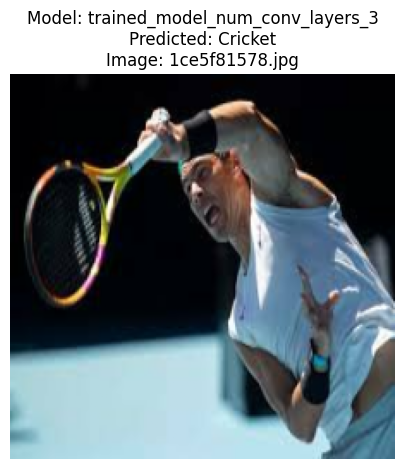

Predictions for trained_model_num_conv_layers_3 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_num_conv_layers_3.csv

Predicting with model: trained_model_optimizers_adam
Loaded model from /content/dataset/trained_model_optimizers_adam.keras
Generating predictions and displaying images...


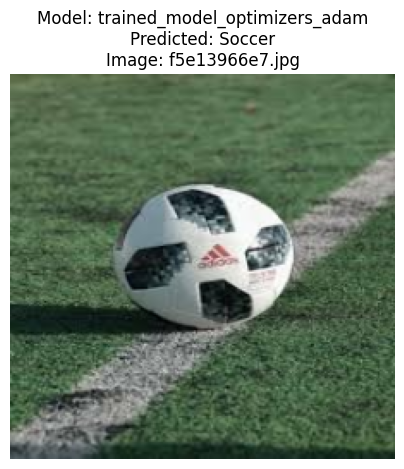

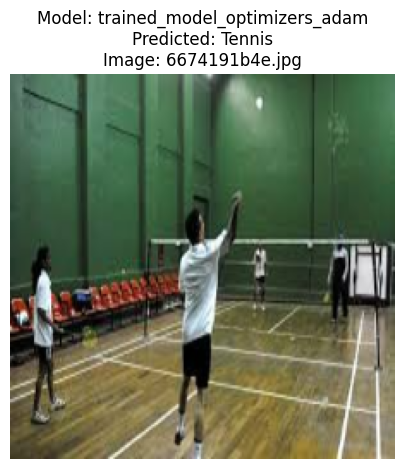

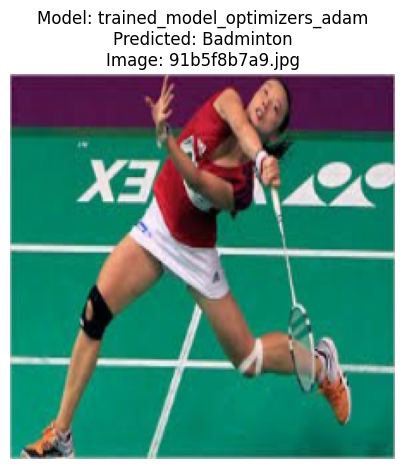

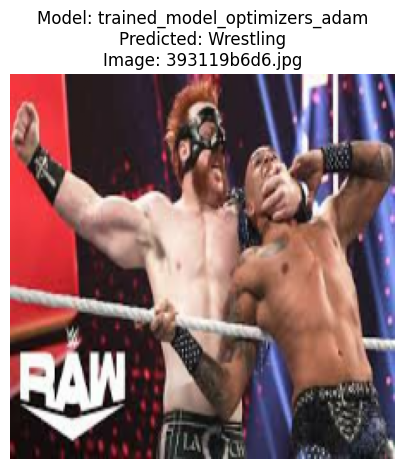

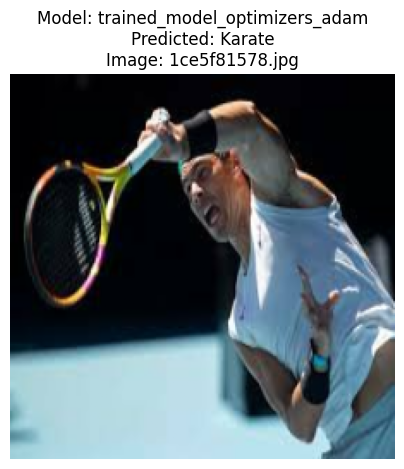

Predictions for trained_model_optimizers_adam saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_optimizers_adam.csv

Predicting with model: trained_model_optimizers_sgd
Loaded model from /content/dataset/trained_model_optimizers_sgd.keras
Generating predictions and displaying images...


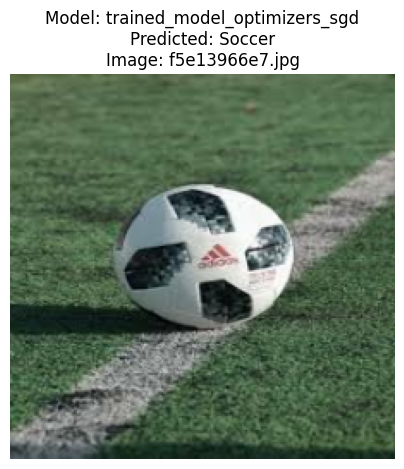

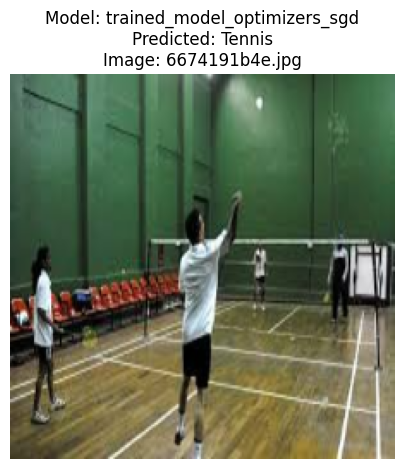

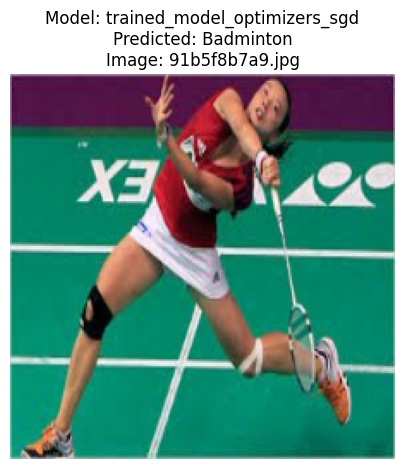

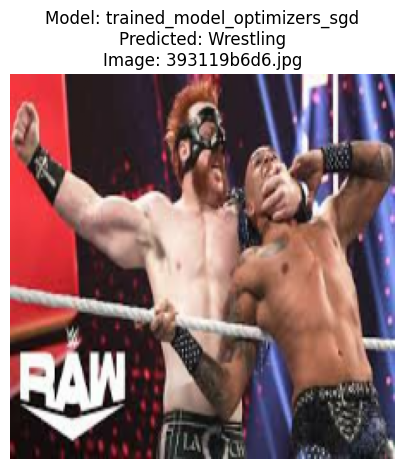

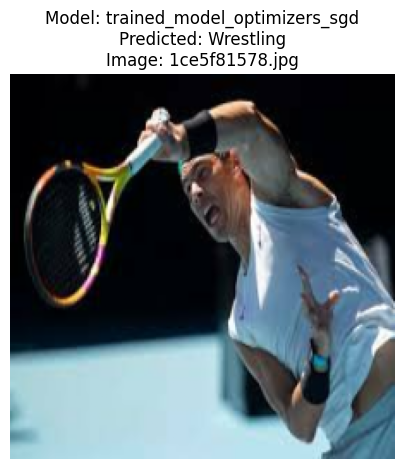

Predictions for trained_model_optimizers_sgd saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_optimizers_sgd.csv

Predicting with model: trained_model_num_conv_layers_2
Loaded model from /content/dataset/trained_model_num_conv_layers_2.keras
Generating predictions and displaying images...


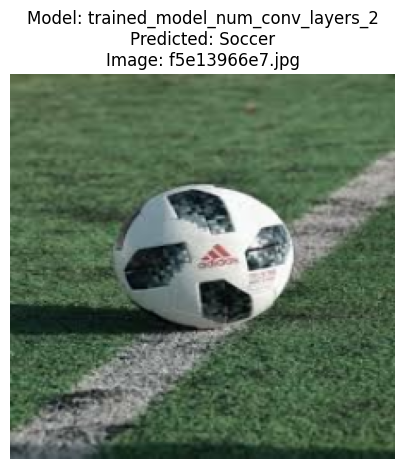

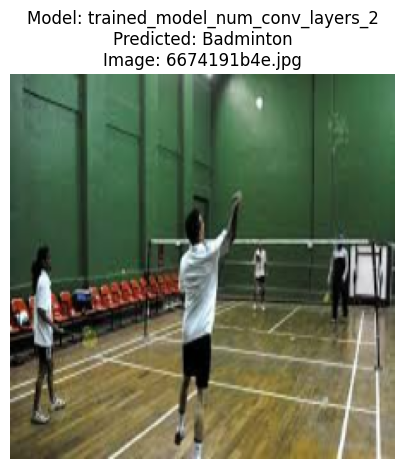

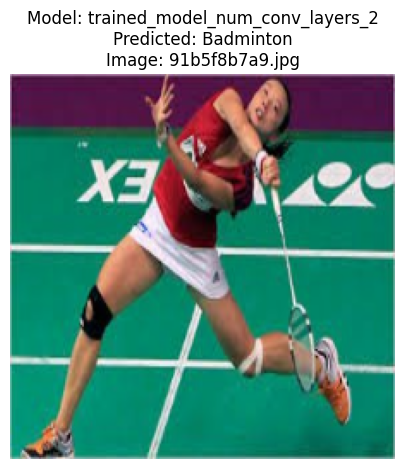

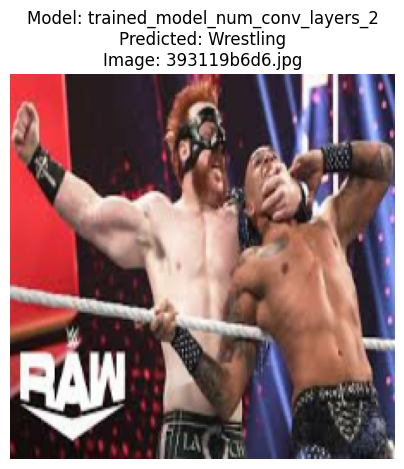

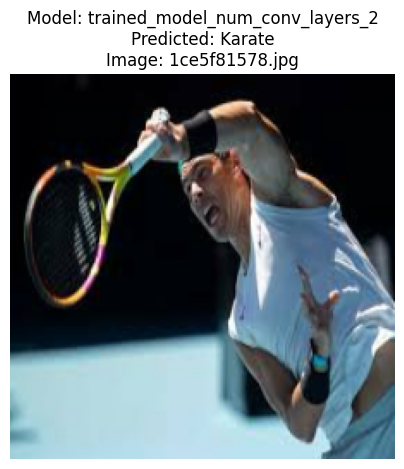

Predictions for trained_model_num_conv_layers_2 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_num_conv_layers_2.csv

Predicting with model: trained_model_learning_rates_0_001
Loaded model from /content/dataset/trained_model_learning_rates_0_001.keras
Generating predictions and displaying images...


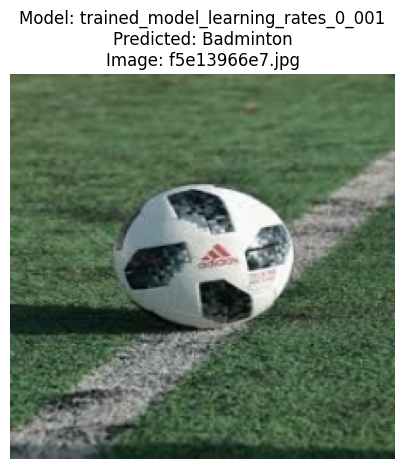

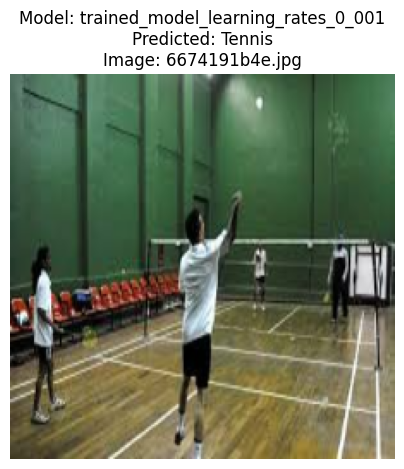

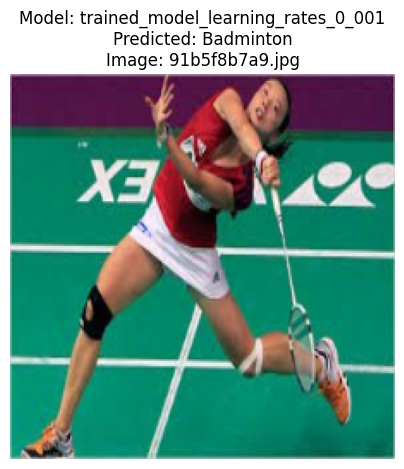

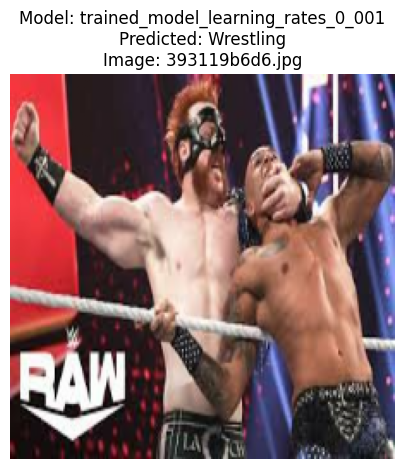

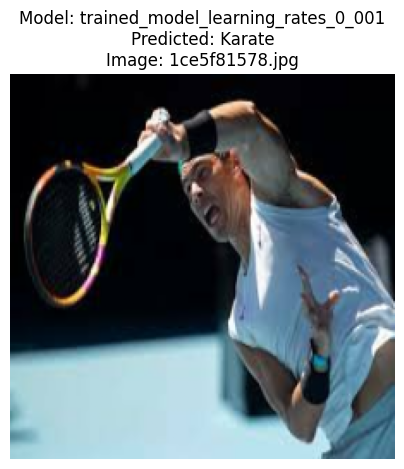

Predictions for trained_model_learning_rates_0_001 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_learning_rates_0_001.csv

Predicting with model: trained_model_dropout_rates_0_2
Loaded model from /content/dataset/trained_model_dropout_rates_0_2.keras
Generating predictions and displaying images...


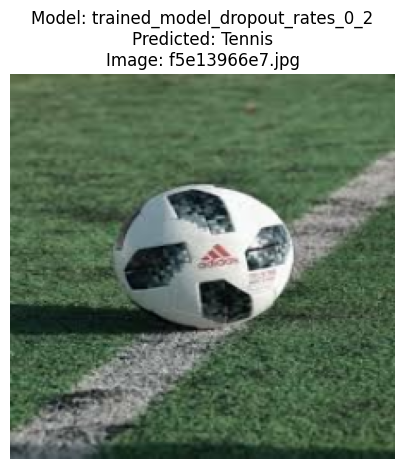

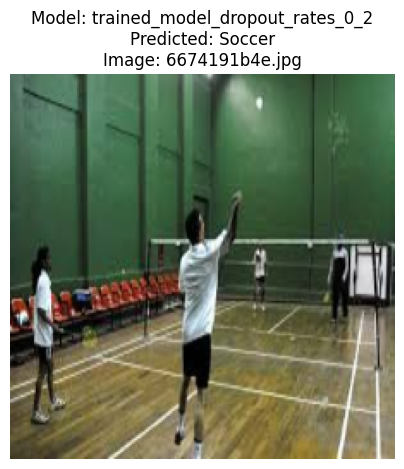

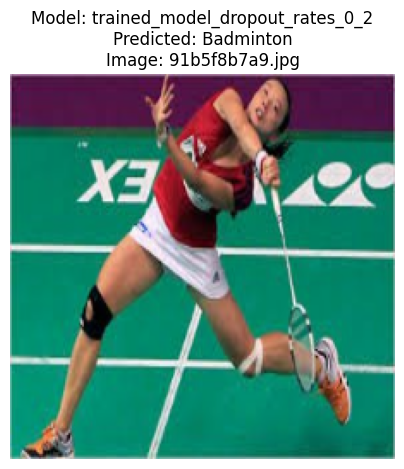

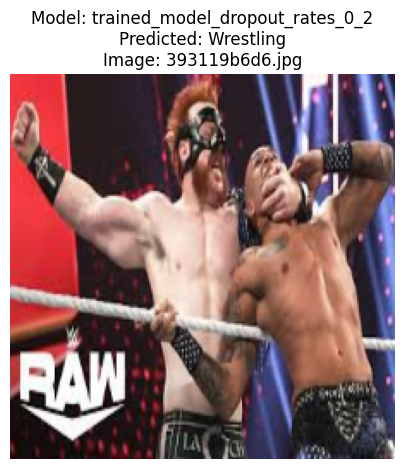

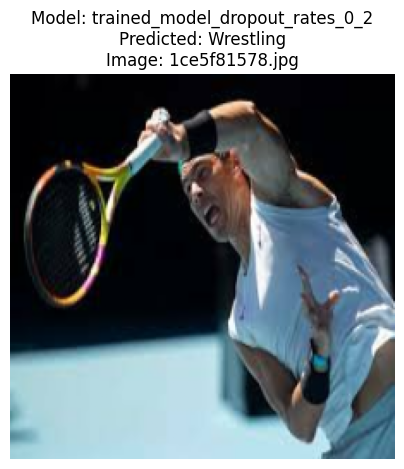

Predictions for trained_model_dropout_rates_0_2 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_dropout_rates_0_2.csv

Predicting with model: trained_model_num_conv_layers_4
Loaded model from /content/dataset/trained_model_num_conv_layers_4.keras
Generating predictions and displaying images...


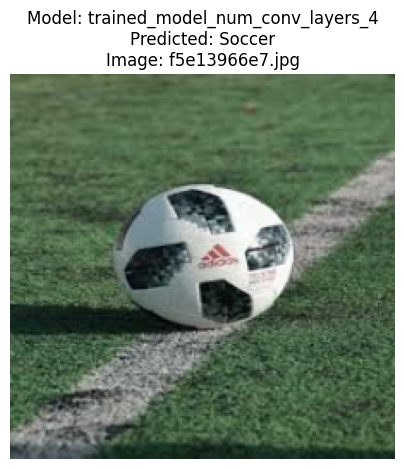

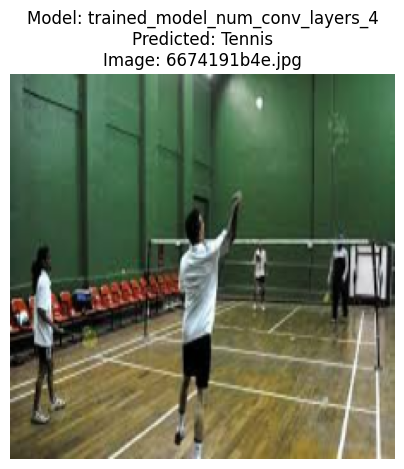

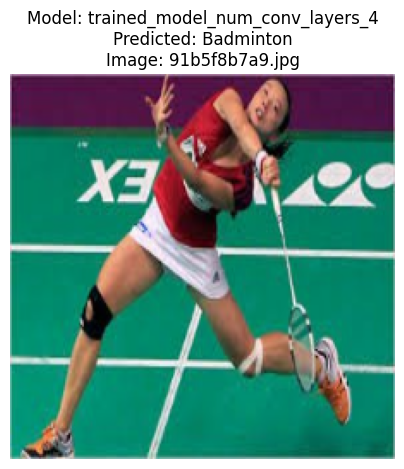

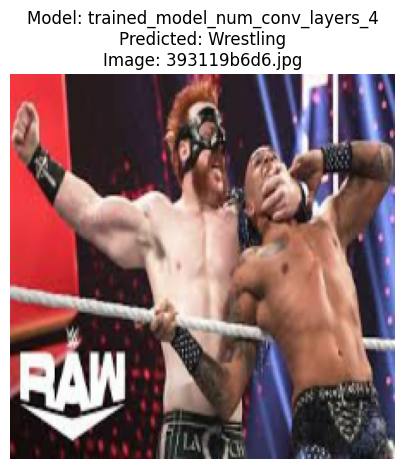

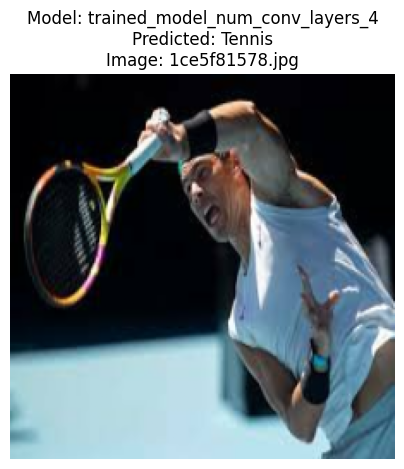

Predictions for trained_model_num_conv_layers_4 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_num_conv_layers_4.csv

Predicting with model: trained_model_optimizers_rmsprop
Loaded model from /content/dataset/trained_model_optimizers_rmsprop.keras
Generating predictions and displaying images...


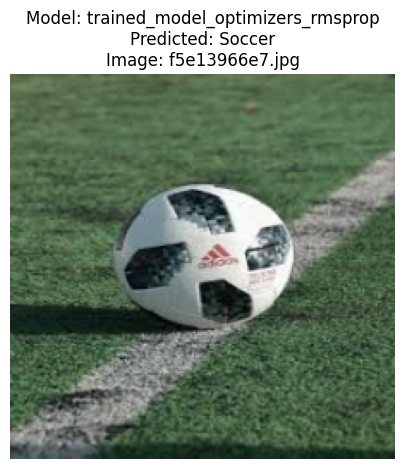

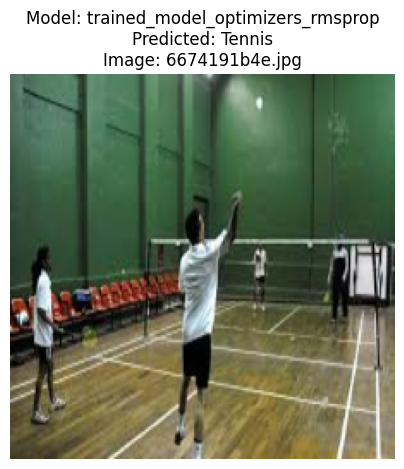

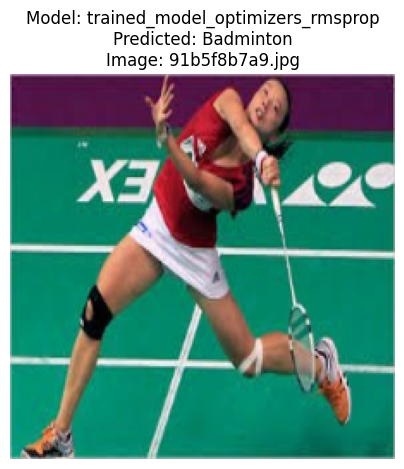

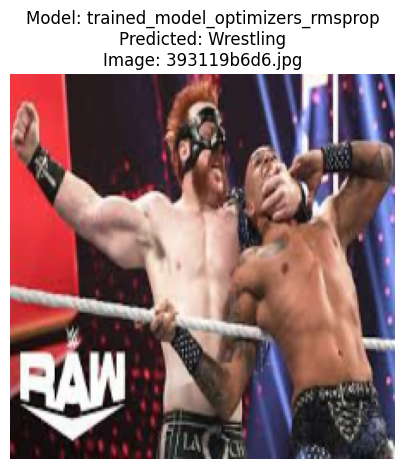

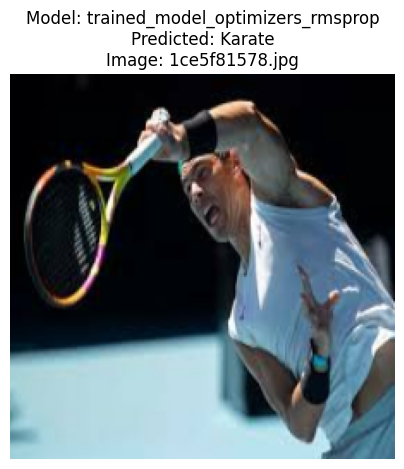

Predictions for trained_model_optimizers_rmsprop saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_optimizers_rmsprop.csv

Predicting with model: trained_model_dropout_rates_0_3
Loaded model from /content/dataset/trained_model_dropout_rates_0_3.keras
Generating predictions and displaying images...


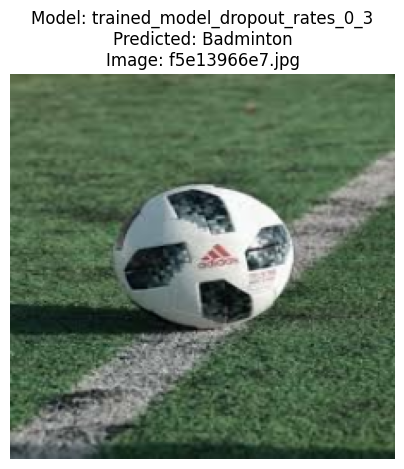

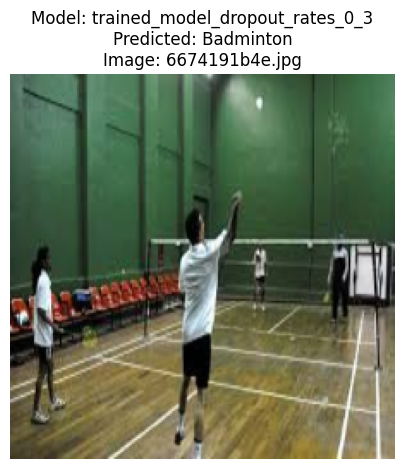

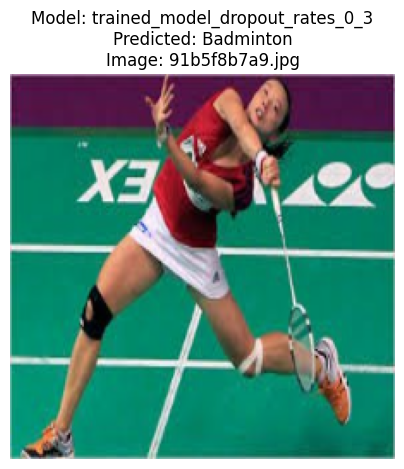

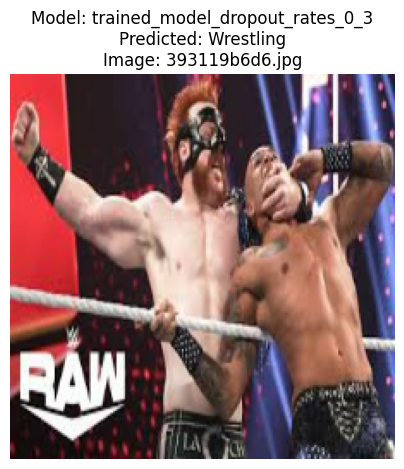

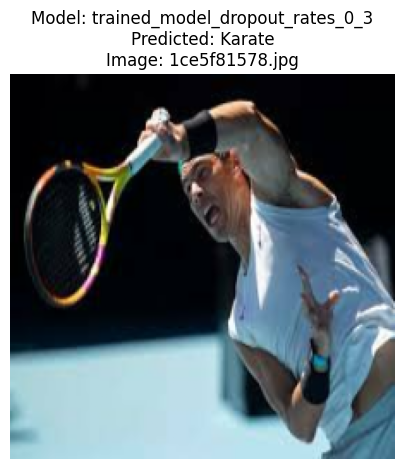

Predictions for trained_model_dropout_rates_0_3 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_dropout_rates_0_3.csv

Predicting with model: trained_model_batch_sizes_128
Loaded model from /content/dataset/trained_model_batch_sizes_128.keras
Generating predictions and displaying images...


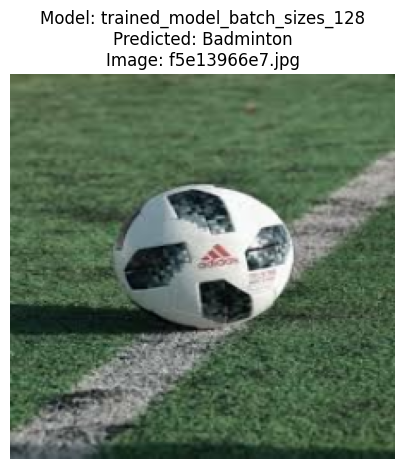

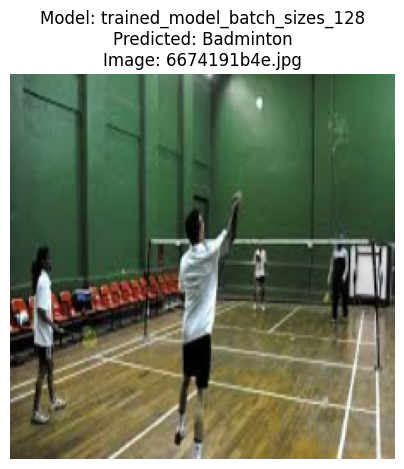

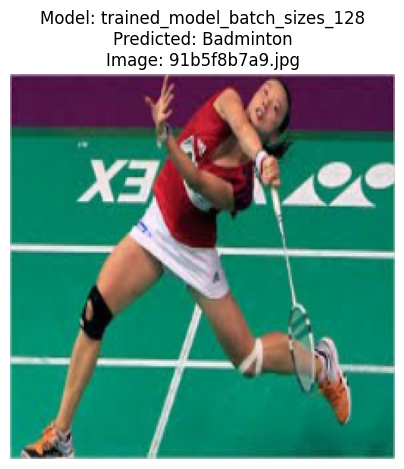

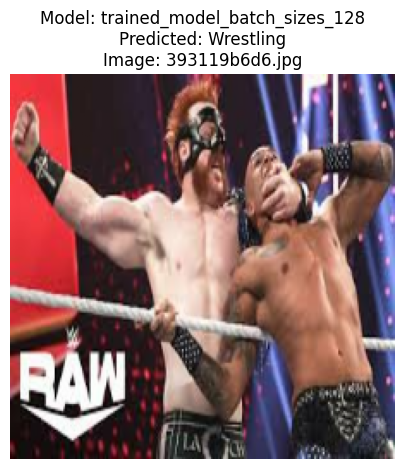

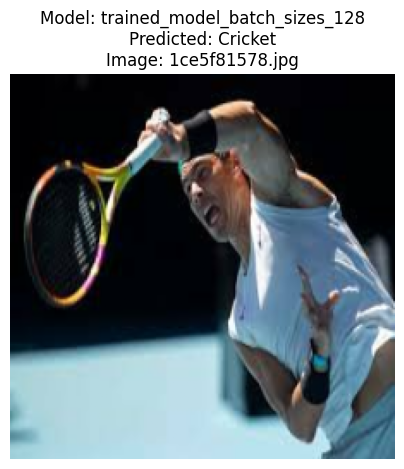

Predictions for trained_model_batch_sizes_128 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_batch_sizes_128.csv

Predicting with model: trained_model_l2_lambdas_0_0
Loaded model from /content/dataset/trained_model_l2_lambdas_0_0.keras
Generating predictions and displaying images...


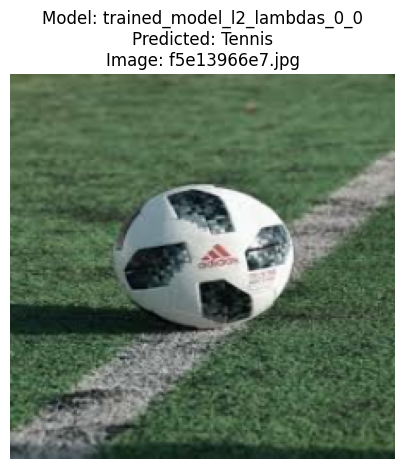

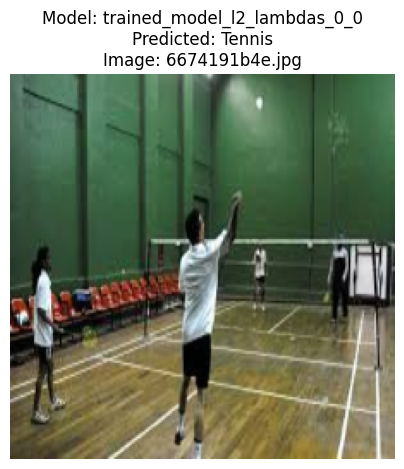

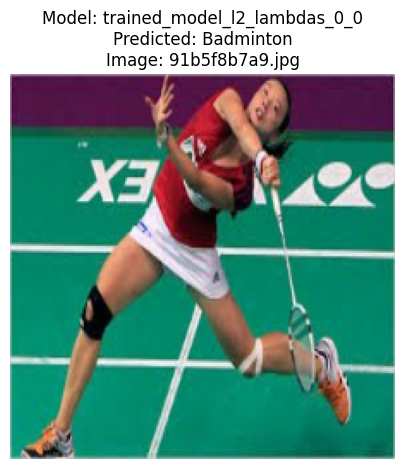

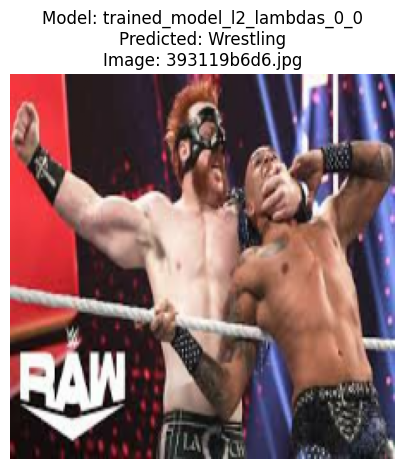

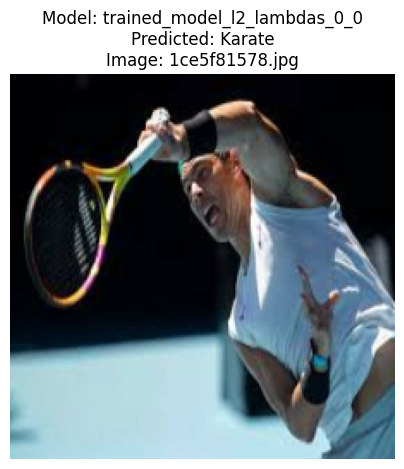

Predictions for trained_model_l2_lambdas_0_0 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_l2_lambdas_0_0.csv

Predicting with model: trained_model_learning_rates_0_0001
Loaded model from /content/dataset/trained_model_learning_rates_0_0001.keras
Generating predictions and displaying images...


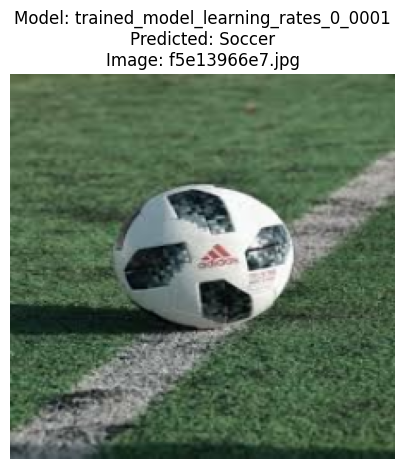

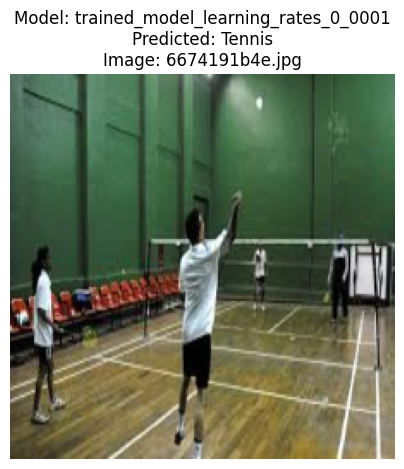

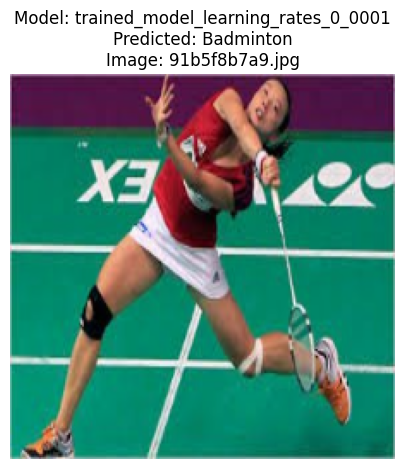

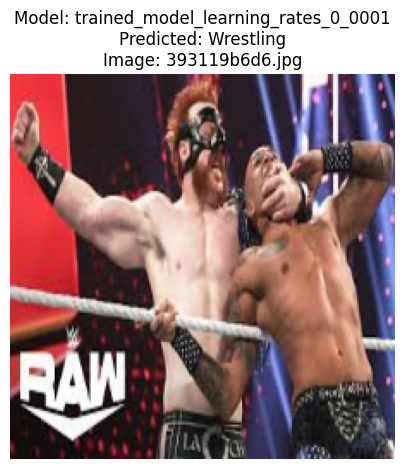

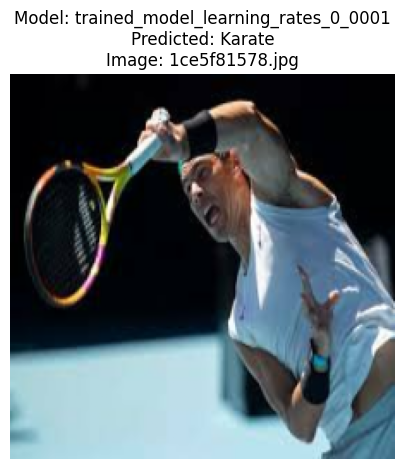

Predictions for trained_model_learning_rates_0_0001 saved to /content/dataset/test_results/20250512-045121/predictions_trained_model_learning_rates_0_0001.csv

Prediction complete for all models.


In [ ]:
import pandas as pd
import json
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Paths (adjust as needed)
current_dir = "/content/dataset"
test_csv_path = os.path.join(current_dir, 'test.csv')
label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
image_dir = '/content/dataset/test'  # Update to your test images directory
results_dir = os.path.join(current_dir, "test_results", datetime.now().strftime("%Y%m%d-%H%M%S"))

# Ensure results directory exists
os.makedirs(results_dir, exist_ok=True)

# Number of images to display per model (adjust as needed)
max_images_to_display = 5  # Set to -1 to display all images

# Debug: Check image_dir
print(f"Image directory: {image_dir}")
print("Directory exists:", os.path.exists(image_dir))
if os.path.exists(image_dir):
    print("Sample files in image_dir:", os.listdir(image_dir)[:5])

# Function to load and preprocess images
def load_and_preprocess_image(image_id):
    try:
        image_id = tf.strings.split(image_id, '/')[-1]
        img_path = tf.strings.join([image_dir, '/', image_id])
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])  # Resize to match training
        img = img / 255.0  # Normalize to [0,1] to match training
        return img, img_path
    except tf.errors.InvalidArgumentError as e:
        print(f"Error loading image {image_id}: {e}")
        return tf.zeros([224, 224, 3], dtype=tf.float32), img_path

# Main prediction function
def predict_models():
    # Check if test.csv exists
    if not os.path.exists(test_csv_path):
        print(f"Error: The file {test_csv_path} does not exist.")
        return

    # Load test.csv
    print("Loading test.csv...")
    try:
        df_test = pd.read_csv(test_csv_path)
        # Check for image_ID column (adjust name if different)
        image_id_col = 'image_ID'  # Update to match your column name, e.g., 'ImageID'
        if image_id_col not in df_test.columns:
            print(f"Error: '{image_id_col}' column not found in test.csv.")
            print("Available columns:", df_test.columns.tolist())
            return
        print(f"Loaded test.csv with {len(df_test)} entries.")
        print("Sample image_IDs:", df_test[image_id_col].head().to_list())
    except Exception as e:
        print(f"Error loading test.csv: {e}")
        return

    # Load label mapping to decode predictions
    try:
        with open(label_mapping_path, 'r') as f:
            label_mapping = json.load(f)
        num_classes = len(label_mapping)
        print("\nLabel Mapping Loaded:")
        for label, encoded in label_mapping.items():
            print(f"{label}: {encoded}")
        # Create reverse mapping for decoding predictions
        reverse_mapping = {v: k for k, v in label_mapping.items()}
    except Exception as e:
        print(f"Error loading label mapping: {e}")
        return

    # Check for missing images
    print("\nChecking for missing images...")
    valid_rows = []
    missing_images = []
    for idx, row in df_test.iterrows():
        image_id = row[image_id_col].split('/')[-1]
        image_path = os.path.join(image_dir, image_id)
        if idx < 5:  # Debug: Print first 5 paths
            print(f"Checking {image_path}: {os.path.exists(image_path)}")
        if os.path.exists(image_path):
            valid_rows.append(row)
        else:
            missing_images.append(row[image_id_col])
    if missing_images:
        print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
        df_test = pd.DataFrame(valid_rows).reset_index(drop=True)
        print(f"Filtered test dataset to {len(df_test)} valid entries.")
    else:
        print("All images found.")

    if len(df_test) == 0:
        print("Error: No valid images found after filtering.")
        return

    # Create TensorFlow dataset (no labels)
    print("\nCreating TensorFlow test dataset...")
    test_dataset = tf.data.Dataset.from_tensor_slices(
        df_test[image_id_col].values
    )
    test_dataset = test_dataset.map(
        load_and_preprocess_image,
        num_parallel_calls=tf.data.AUTOTUNE
    ).filter(lambda x, _: tf.reduce_any(tf.not_equal(x, 0)))
    test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

    # Find all .keras model files
    model_files = [f for f in os.listdir(current_dir) if f.endswith('.keras')]
    if not model_files:
        print("Error: No .keras models found in the current directory.")
        print("Available files:", os.listdir(current_dir))
        return
    print("\nFound models:", model_files)

    # Iterate over each model
    for model_file in model_files:
        model_path = os.path.join(current_dir, model_file)
        run_name = model_file.replace('.keras', '')
        print(f"\nPredicting with model: {run_name}")

        try:
            # Load model
            model = tf.keras.models.load_model(model_path)
            print(f"Loaded model from {model_path}")

            # Generate predictions and display images
            print("Generating predictions and displaying images...")
            predictions = []
            num_displayed = 0

            # Iterate over dataset to get images and paths
            for batch_images, batch_paths in test_dataset:
                # Predict on batch
                batch_preds = model.predict(batch_images, verbose=0)
                batch_pred_classes = np.argmax(batch_preds, axis=1)
                batch_pred_labels = [reverse_mapping.get(pred, "Unknown") for pred in batch_pred_classes]

                # Process each image in the batch
                for img, path, pred_label in zip(batch_images, batch_paths, batch_pred_labels):
                    img_id = path.numpy().decode('utf-8').split('/')[-1]
                    predictions.append({'image_ID': img_id, 'predicted_label': pred_label})

                    # Display image if within limit
                    if max_images_to_display == -1 or num_displayed < max_images_to_display:
                        plt.figure(figsize=(5, 5))
                        plt.imshow(img.numpy())
                        plt.title(f"Model: {run_name}\nPredicted: {pred_label}\nImage: {img_id}")
                        plt.axis('off')
                        plt.show()
                        num_displayed += 1

            # Save predictions to CSV
            predictions_df = pd.DataFrame(predictions)
            predictions_path = os.path.join(results_dir, f'predictions_{run_name}.csv')
            predictions_df.to_csv(predictions_path, index=False)
            print(f"Predictions for {run_name} saved to {predictions_path}")

        except Exception as e:
            print(f"Error predicting with model {run_name}: {e}")
            continue

    print("\nPrediction complete for all models.")

# Run the prediction
if __name__ == "__main__":
    # Ensure matplotlib inline for Colab
    %matplotlib inline
    predict_models()

In [ ]:

# summarize_predictions.py
import pandas as pd
import os
from collections import Counter
import glob

# Path to results directory (same as in prediction script)
results_dir = "/content/dataset/test_results/20250512-045121"  # Update with the correct timestamp

# Path to test.csv to get total images
test_csv_path = "/content/dataset/test.csv"

# Main summarization function
def summarize_predictions():
    # Check if results_dir exists
    if not os.path.exists(results_dir):
        print(f"Error: The directory {results_dir} does not exist.")
        return

    # Load test.csv to get total images
    try:
        df_test = pd.read_csv(test_csv_path)
        total_images = len(df_test)
        print(f"Total images in test.csv: {total_images}")
    except Exception as e:
        print(f"Error loading test.csv: {e}")
        return

    # Load missing images list
    missing_images_path = os.path.join(results_dir, 'missing_images.txt')
    if os.path.exists(missing_images_path):
        with open(missing_images_path, 'r') as f:
            missing_images = f.read().splitlines()
        missing_count = len(missing_images)
        print(f"Missing images: {missing_count}")
    else:
        missing_count = 0
        missing_images = []
        print("No missing images list found. Assuming 0 missing images.")

    valid_images = total_images - missing_count
    print(f"Valid images processed: {valid_images}")

    # Find all prediction CSV files
    prediction_files = glob.glob(os.path.join(results_dir, 'predictions_*.csv'))
    if not prediction_files:
        print("Error: No prediction CSV files found in the results directory.")
        print("Available files:", os.listdir(results_dir))
        return
    print("\nFound prediction files:", [os.path.basename(f) for f in prediction_files])

    # Iterate over each prediction file
    for prediction_file in prediction_files:
        run_name = os.path.basename(prediction_file).replace('predictions_', '').replace('.csv', '')
        print(f"\nSummarizing predictions for model: {run_name}")

        try:
            # Load predictions
            df_predictions = pd.read_csv(prediction_file)
            predicted_labels = df_predictions['predicted_label'].to_list()

            # Generate label distribution
            label_counts = Counter(predicted_labels)
            print("\nSummary for Model:", run_name)
            print(f"Total images in test.csv: {total_images}")
            print(f"Missing images: {missing_count}")
            print(f"Valid images processed: {valid_images}")
            print("Predicted label distribution:")
            for label, count in label_counts.items():
                print(f"  {label}: {count} ({count/valid_images*100:.1f}%)")

            # Save summary to text file
            summary_path = os.path.join(results_dir, f'summary_{run_name}.txt')
            with open(summary_path, 'w') as f:
                f.write(f"Summary for Model: {run_name}\n")
                f.write(f"Total images in test.csv: {total_images}\n")
                f.write(f"Missing images: {missing_count}\n")
                f.write(f"Valid images processed: {valid_images}\n")
                f.write("Predicted label distribution:\n")
                for label, count in label_counts.items():
                    f.write(f"  {label}: {count} ({count/valid_images*100:.1f}%)\n")
            print(f"Summary saved to {summary_path}")

        except Exception as e:
            print(f"Error summarizing predictions for {run_name}: {e}")
            continue

    print("\nSummarization complete for all models.")

# Run the summarization
if __name__ == "__main__":
    summarize_predictions()

Total images in test.csv: 2056
No missing images list found. Assuming 0 missing images.
Valid images processed: 2056

Found prediction files: ['predictions_trained_model_l2_lambdas_0_0.csv', 'predictions_trained_model_dropout_rates_0_3.csv', 'predictions_trained_model_dropout_rates_0_5.csv', 'predictions_trained_model_batch_sizes_128.csv', 'predictions_trained_model_optimizers_rmsprop.csv', 'predictions_trained_model_num_conv_layers_3.csv', 'predictions_trained_model_num_conv_layers_2.csv', 'predictions_trained_model_learning_rates_0_0001.csv', 'predictions_trained_model_batch_sizes_32.csv', 'predictions_trained_model_optimizers_sgd.csv', 'predictions_trained_model_learning_rates_0_001.csv', 'predictions_trained_model_batch_sizes_64.csv', 'predictions_trained_model_num_conv_layers_4.csv', 'predictions_trained_model_l2_lambdas_0_01.csv', 'predictions_trained_model_l2_lambdas_0_001.csv', 'predictions_trained_model_dropout_rates_0_2.csv', 'predictions_trained_model_optimizers_adam.csv']



In [ ]:
import pandas as pd
results_dir = "/content/dataset/test_results/20250512-045121"
for file_name in os.listdir(results_dir):
    if file_name.endswith('.csv'):
        file_path = os.path.join(results_dir, file_name)
        df = pd.read_csv(file_path)
        print(f"\nContents of {file_name}:")
        print(df.head())


Contents of predictions_trained_model_l2_lambdas_0_0.csv:
         image_ID predicted_label
0  f5e13966e7.jpg          Tennis
1  6674191b4e.jpg          Tennis
2  91b5f8b7a9.jpg       Badminton
3  393119b6d6.jpg       Wrestling
4  1ce5f81578.jpg          Karate

Contents of predictions_trained_model_dropout_rates_0_3.csv:
         image_ID predicted_label
0  f5e13966e7.jpg       Badminton
1  6674191b4e.jpg       Badminton
2  91b5f8b7a9.jpg       Badminton
3  393119b6d6.jpg       Wrestling
4  1ce5f81578.jpg          Karate

Contents of predictions_trained_model_dropout_rates_0_5.csv:
         image_ID predicted_label
0  f5e13966e7.jpg         Cricket
1  6674191b4e.jpg         Cricket
2  91b5f8b7a9.jpg         Cricket
3  393119b6d6.jpg         Cricket
4  1ce5f81578.jpg         Cricket

Contents of predictions_trained_model_batch_sizes_128.csv:
         image_ID predicted_label
0  f5e13966e7.jpg       Badminton
1  6674191b4e.jpg       Badminton
2  91b5f8b7a9.jpg       Badminton
3  393119

In [ ]:
import pandas as pd
results_dir = "/content/dataset/test_results/20250512-045121"
for file_name in os.listdir(results_dir):
    if file_name.endswith('.txt'):
        file_path = os.path.join(results_dir, file_name)
        df = pd.read_csv(file_path)
        print(f"\nContents of {file_name}:")
        print(df)


Contents of summary_trained_model_l2_lambdas_0_01.txt:
   Summary for Model: trained_model_l2_lambdas_0_01
0                    Total images in test.csv: 2056
1                                 Missing images: 0
2                      Valid images processed: 2056
3                     Predicted label distribution:
4                              Cricket: 406 (19.7%)
5                            Badminton: 228 (11.1%)
6                            Wrestling: 504 (24.5%)
7                               Karate: 370 (18.0%)
8                               Soccer: 339 (16.5%)
9                              Swimming: 193 (9.4%)
10                                Tennis: 16 (0.8%)

Contents of summary_trained_model_batch_sizes_64.txt:
   Summary for Model: trained_model_batch_sizes_64
0                   Total images in test.csv: 2056
1                                Missing images: 0
2                     Valid images processed: 2056
3                    Predicted label distribution:
4         

In [ ]:
from google.colab import files
import os
import zipfile

# Path to the results directory
results_dir = "/content/dataset/test_results/20250512-045121"

# Verify the directory exists and list its contents
if not os.path.exists(results_dir):
    print(f"Error: The directory {results_dir} does not exist.")
else:
    print("Files in directory:", os.listdir(results_dir))

    # Create a zip file of the entire directory
    zip_path = "/content/test_results_20250512-045121.zip"
    with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files_list in os.walk(results_dir):
            for file in files_list:
                file_path = os.path.join(root, file)
                # Preserve the folder structure relative to results_dir
                arcname = os.path.relpath(file_path, os.path.dirname(results_dir))
                zipf.write(file_path, arcname)

    # Download the zip file
    files.download(zip_path)
    print(f"Downloaded {zip_path}")

Files in directory: ['summary_trained_model_l2_lambdas_0_01.txt', 'predictions_trained_model_l2_lambdas_0_0.csv', 'summary_trained_model_batch_sizes_64.txt', 'summary_trained_model_l2_lambdas_0_0.txt', 'predictions_trained_model_dropout_rates_0_3.csv', 'summary_trained_model_dropout_rates_0_2.txt', 'summary_trained_model_optimizers_rmsprop.txt', 'predictions_trained_model_dropout_rates_0_5.csv', 'summary_trained_model_dropout_rates_0_3.txt', 'summary_trained_model_optimizers_sgd.txt', 'predictions_trained_model_batch_sizes_128.csv', 'summary_trained_model_learning_rates_0_001.txt', 'predictions_trained_model_optimizers_rmsprop.csv', 'predictions_trained_model_num_conv_layers_3.csv', 'predictions_trained_model_num_conv_layers_2.csv', 'summary_trained_model_l2_lambdas_0_001.txt', 'summary_trained_model_learning_rates_0_0001.txt', 'summary_trained_model_dropout_rates_0_5.txt', 'summary_trained_model_batch_sizes_32.txt', 'predictions_trained_model_learning_rates_0_0001.csv', 'predictions_t

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Downloaded /content/test_results_20250512-045121.zip


In [ ]:
# import pandas as pd
# import json
# import os
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras.optimizers import SGD

# # Hyperparameters
# hyperparams = {
#     "num_layers": 3,
#     "dropout_rate": 0.3,
#     "l2_lambda": 0.01,
#     "batch_size": 32,
#     "optimizer": "sgd"
# }

# # Paths
# input_dir = '/content/dataset'
# current_dir = "/content/dataset"
# train_csv_path = os.path.join(input_dir, 'train.csv')
# train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
# label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
# image_dir = '/content/dataset/image_normalized'  # Matches error message

# # Function to load and preprocess images
# def load_and_preprocess_image(image_id, label):
#     try:
#         # Remove any subdirectory from image_id
#         image_id = tf.strings.split(image_id, '/')[-1]
#         # Construct image path
#         img_path = tf.strings.join([image_dir, '/', image_id])
#         img = tf.io.read_file(img_path)
#         img = tf.image.decode_jpeg(img, channels=3)  # Adjust for PNG or other formats if needed
#         img = tf.image.resize(img, [224, 224])  # Adjust size as needed
#         img = img / 255.0  # Normalize to [0, 1]
#         return img, label
#     except tf.errors.InvalidArgumentError as e:
#         print(f"Error loading image {image_id}: {e}")
#         # Return a dummy image to maintain dataset structure
#         return tf.zeros([224, 224, 3], dtype=tf.float32), label

# # Main processing
# if not os.path.exists(train_csv_path):
#     print(f"Error: The file {train_csv_path} does not exist.")
#     print("Please ensure the dataset is uploaded or mounted correctly.")
#     print("Example: Upload dataset zip and unzip with '!unzip /content/dataset.zip -d /content/'")
#     print("Or mount Google Drive: 'from google.colab import drive; drive.mount('/content/drive')'")
# else:
#     # 2. Load train.csv
#     print("Loading train.csv...")
#     try:
#         df_train = pd.read_csv(train_csv_path)
#         if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
#             print("Error: 'label' or 'image_ID' column not found in train.csv. Please check column names.")
#         else:
#             print(f"Loaded train.csv with {len(df_train)} entries.")

#             # 3. Create label mapping
#             print("\nCreating label mapping from train.csv...")
#             unique_labels = sorted(df_train['label'].unique())  # Sort for consistency
#             label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
#             print("\nLabel Mapping (label: encoded_value):")
#             for label, encoded in label_mapping.items():
#                 print(f"{label}: {encoded}")

#             # Save label mapping
#             try:
#                 with open(label_mapping_path, 'w') as f:
#                     json.dump(label_mapping, f, indent=4)
#                 print(f"\nLabel mapping saved as {label_mapping_path}")
#             except Exception as e:
#                 print(f"Error saving label mapping: {e}")

#             # 4. Encode train.csv labels
#             print("\nEncoding train.csv labels...")
#             try:
#                 df_train['label_encoded'] = df_train['label'].map(label_mapping)
#                 if df_train['label_encoded'].isna().any():
#                     print("Warning: Some labels in train.csv could not be mapped. This should not happen.")
#                 df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')  # Allow NaN
#                 df_train_encoded = df_train[['image_ID', 'label_encoded']]

#                 # Shuffle the DataFrame
#                 print("\nShuffling the data...")
#                 df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)

#                 # Save shuffled DataFrame
#                 df_train_encoded.to_csv(train_encoded_csv_path, index=False)
#                 print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")

#                 # --- Training Phase ---
#                 print("\nStarting training phase...")

#                 # Load label mapping to get number of classes
#                 try:
#                     with open(label_mapping_path, 'r') as f:
#                         label_mapping = json.load(f)
#                     num_classes = len(label_mapping)
#                 except Exception as e:
#                     print(f"Error loading label mapping: {e}")
#                     raise

#                 # Load encoded data
#                 try:
#                     df_encoded = pd.read_csv(train_encoded_csv_path)
#                     if 'image_ID' not in df_encoded.columns or 'label_encoded' not in df_encoded.columns:
#                         print("Error: 'image_ID' or 'label_encoded' column not found in train_encoded.csv.")
#                         raise
#                 except Exception as e:
#                     print(f"Error loading train_encoded.csv: {e}")
#                     raise

#                 # Filter out rows with missing images
#                 print("\nChecking for missing images...")
#                 valid_rows = []
#                 missing_images = []
#                 for idx, row in df_encoded.iterrows():
#                     image_id = row['image_ID'].split('/')[-1]  # Strip subdirectory
#                     image_path = os.path.join(image_dir, image_id)
#                     if os.path.exists(image_path):
#                         valid_rows.append(row)
#                     else:
#                         missing_images.append(row['image_ID'])
#                 if missing_images:
#                     print(f"Warning: {len(missing_images)} images are missing, including: {missing_images[:5]}")
#                     df_encoded = pd.DataFrame(valid_rows).reset_index(drop=True)
#                     print(f"Filtered dataset to {len(df_encoded)} valid entries.")
#                 else:
#                     print("All images found.")

#                 if len(df_encoded) == 0:
#                     raise ValueError("No valid images found after filtering. Check image_dir and image_ID values.")

#                 # Split data into training and validation (80-20 split)
#                 train_size = int(0.8 * len(df_encoded))
#                 train_df = df_encoded[:train_size]
#                 val_df = df_encoded[train_size:]

#                 # Create TensorFlow datasets
#                 print("Creating TensorFlow datasets...")
#                 train_dataset = tf.data.Dataset.from_tensor_slices(
#                     (train_df['image_ID'].values, train_df['label_encoded'].values)
#                 )
#                 val_dataset = tf.data.Dataset.from_tensor_slices(
#                     (val_df['image_ID'].values, val_df['label_encoded'].values)
#                 )

#                 # Apply image loading and preprocessing
#                 train_dataset = train_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))  # Filter out dummy images
#                 val_dataset = val_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))

#                 # Batch datasets
#                 train_dataset = train_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)
#                 val_dataset = val_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)

#                 # Build CNN model
#                 print("Building CNN model...")
#                 model = Sequential([
#                     Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3),
#                            kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Flatten(),
#                     Dense(128, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(64, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(32, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(num_classes, activation='softmax')
#                 ])

#                 # Compile model
#                 optimizer = SGD() if hyperparams['optimizer'] == 'sgd' else hyperparams['optimizer']
#                 model.compile(optimizer=optimizer,
#                               loss='sparse_categorical_crossentropy',
#                               metrics=['accuracy'])

#                 # Print model summary
#                 model.summary()

#                 # Train model
#                 print("\nTraining model...")
#                 try:
#                     history = model.fit(
#                         train_dataset,
#                         validation_data=val_dataset,
#                         epochs=20,  # Adjust as needed
#                         verbose=1
#                     )

#                     # Save model
#                     model_save_path = os.path.join('/content/dataset/trained_model.keras')
#                     model.save('/content/dataset/trained_model.keras')
#                     print(f"\nModel saved to {model_save_path}")

#                     # Print training results
#                     print("\nTraining complete. Final metrics:")
#                     print(f"Training accuracy: {history.history['accuracy'][-1]:.4f}")
#                     print(f"Validation accuracy: {history.history['val_accuracy'][-1]:.4f}")
#                 except Exception as e:
#                     print(f"Error during training: {e}")

#             except Exception as e:
#                 print(f"Error encoding train.csv: {e}")
#     except Exception as e:
#         print(f"Error loading train.csv: {e}")

 {"num_layers": 3, "dropout_rate": 0.3, "l2_lambda": 0.01, "batch_size": 32, "optimizer": "sgd"}, optimizer=sgd


In [ ]:
# import pandas as pd
# import json
# import os
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras.optimizers import SGD
# import matplotlib.pyplot as plt

# # Hyperparameters
# hyperparams = {
#     "num_layers": 3,
#     "dropout_rate": 0.3,
#     "l2_lambda": 0.01,
#     "batch_size": 32,
#     "optimizer": "sgd"
# }

# # Paths
# input_dir = '/content/dataset'
# current_dir = "/content/dataset"
# train_csv_path = os.path.join(input_dir, 'train.csv')
# train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
# label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
# image_dir = '/content/dataset/image_normalized'  # Matches error message

# # Function to load and preprocess images
# def load_and_preprocess_image(image_id, label):
#     try:
#         # Remove any subdirectory from image_id
#         image_id = tf.strings.split(image_id, '/')[-1]
#         # Construct image path
#         img_path = tf.strings.join([image_dir, '/', image_id])
#         img = tf.io.read_file(img_path)
#         img = tf.image.decode_jpeg(img, channels=3)  # Adjust for PNG or other formats if needed
#         img = tf.image.resize(img, [224, 224])  # Adjust size as needed
#         img = img / 255.0  # Normalize to [0, 1]
#         return img, label
#     except tf.errors.InvalidArgumentError as e:
#         print(f"Error loading image {image_id}: {e}")
#         # Return a dummy image to maintain dataset structure
#         return tf.zeros([224, 224, 3], dtype=tf.float32), label

# # Function to plot training and validation metrics
# def plot_training_history(history):
#     # Extract metrics from history
#     acc = history.history['accuracy']
#     val_acc = history.history['val_accuracy']
#     loss = history.history['loss']
#     val_loss = history.history['val_loss']
#     epochs_range = range(len(acc))

#     # Plot accuracy
#     plt.figure(figsize=(12, 5))

#     plt.subplot(1, 2, 1)
#     plt.plot(epochs_range, acc, label='Training Accuracy')
#     plt.plot(epochs_range, val_acc, label='Validation Accuracy')
#     plt.title('Training and Validation Accuracy')
#     plt.xlabel('Epoch')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.grid(True)

#     # Plot loss
#     plt.subplot(1, 2, 2)
#     plt.plot(epochs_range, loss, label='Training Loss')
#     plt.plot(epochs_range, val_loss, label='Validation Loss')
#     plt.title('Training and Validation Loss')
#     plt.xlabel('Epoch')
#     plt.ylabel('Loss')
#     plt.legend()
#     plt.grid(True)

#     # Adjust layout and display
#     plt.tight_layout()
#     plt.show()

# # Main processing
# if not os.path.exists(train_csv_path):
#     print(f"Error: The file {train_csv_path} does not exist.")
#     print("Please ensure the dataset is uploaded or mounted correctly.")
#     print("Example: Upload dataset zip and unzip with '!unzip /content/dataset.zip -d /content/'")
#     print("Or mount Google Drive: 'from google.colab import drive; drive.mount('/content/drive')'")
# else:
#     # 2. Load train.csv
#     print("Loading train.csv...")
#     try:
#         df_train = pd.read_csv(train_csv_path)
#         if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
#             print("Error: 'label' or 'image_ID' column not found in train.csv. Please check column names.")
#         else:
#             print(f"Loaded train.csv with {len(df_train)} entries.")

#             # 3. Create label mapping
#             print("\nCreating label mapping from train.csv...")
#             unique_labels = sorted(df_train['label'].unique())  # Sort for consistency
#             label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
#             print("\nLabel Mapping (label: encoded_value):")
#             for label, encoded in label_mapping.items():
#                 print(f"{label}: {encoded}")

#             # Save label mapping
#             try:
#                 with open(label_mapping_path, 'w') as f:
#                     json.dump(label_mapping, f, indent=4)
#                 print(f"\nLabel mapping saved as {label_mapping_path}")
#             except Exception as e:
#                 print(f"Error saving label mapping: {e}")

#             # 4. Encode train.csv labels
#             print("\nEncoding train.csv labels...")
#             try:
#                 df_train['label_encoded'] = df_train['label'].map(label_mapping)
#                 if df_train['label_encoded'].isna().any():
#                     print("Warning: Some labels in train.csv could not be mapped. This should not happen.")
#                 df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')  # Allow NaN
#                 df_train_encoded = df_train[['image_ID', 'label_encoded']]

#                 # Shuffle the DataFrame
#                 print("\nShuffling the data...")
#                 df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)

#                 # Save shuffled DataFrame
#                 df_train_encoded.to_csv(train_encoded_csv_path, index=False)
#                 print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")

#                 # --- Training Phase ---
#                 print("\nStarting training phase...")

#                 # Load label mapping to get number of classes
#                 try:
#                     with open(label_mapping_path, 'r') as f:
#                         label_mapping = json.load(f)
#                     num_classes = len(label_mapping)
#                 except Exception as e:
#                     print(f"Error loading label mapping: {e}")
#                     raise

#                 # Load encoded data
#                 try:
#                     df_encoded = pd.read_csv(train_encoded_csv_path)
#                     if 'image_ID' not in df_encoded.columns or 'label_encoded' not in df_encoded.columns:
#                         print("Error: 'image_ID' or 'label_encoded' column not found in train_encoded.csv.")
#                         raise
#                 except Exception as e:
#                     print(f"Error loading train_encoded.csv: {e}")
#                     raise

#                 # Filter out rows with missing images
#                 print("\nChecking for missing images...")
#                 valid_rows = []
#                 missing_images = []
#                 for idx, row in df_encoded.iterrows():
#                     image_id = row['image_ID'].split('/')[-1]  # Strip subdirectory
#                     image_path = os.path.join(image_dir, image_id)
#                     if os.path.exists(image_path):
#                         valid_rows.append(row)
#                     else:
#                         missing_images.append(row['image_ID'])
#                 if missing_images:
#                     print(f"Warning: {len(missing_images)} images are missing, including: {missing_images[:5]}")
#                     df_encoded = pd.DataFrame(valid_rows).reset_index(drop=True)
#                     print(f"Filtered dataset to {len(df_encoded)} valid entries.")
#                 else:
#                     print("All images found.")

#                 if len(df_encoded) == 0:
#                     raise ValueError("No valid images found after filtering. Check image_dir and image_ID values.")

#                 # Split data into training and validation (80-20 split)
#                 train_size = int(0.8 * len(df_encoded))
#                 train_df = df_encoded[:train_size]
#                 val_df = df_encoded[train_size:]

#                 # Create TensorFlow datasets
#                 print("Creating TensorFlow datasets...")
#                 train_dataset = tf.data.Dataset.from_tensor_slices(
#                     (train_df['image_ID'].values, train_df['label_encoded'].values)
#                 )
#                 val_dataset = tf.data.Dataset.from_tensor_slices(
#                     (val_df['image_ID'].values, val_df['label_encoded'].values)
#                 )

#                 # Apply image loading and preprocessing
#                 train_dataset = train_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))  # Filter out dummy images
#                 val_dataset = val_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))

#                 # Batch datasets
#                 train_dataset = train_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)
#                 val_dataset = val_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)

#                 # Build CNN model
#                 print("Building CNN model...")
#                 model = Sequential([
#                     Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3),
#                            kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Flatten(),
#                     Dense(128, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(64, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(32, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(num_classes, activation='softmax')
#                 ])

#                 # Compile model
#                 optimizer = SGD() if hyperparams['optimizer'] == 'sgd' else hyperparams['optimizer']
#                 model.compile(optimizer=optimizer,
#                               loss='sparse_categorical_crossentropy',
#                               metrics=['accuracy'])

#                 # Print model summary
#                 model.summary()

#                 # Train model
#                 print("\nTraining model...")
#                 try:
#                     history = model.fit(
#                         train_dataset,
#                         validation_data=val_dataset,
#                         epochs=30,  # Adjust as needed
#                         verbose=1
#                     )
#                     # Save model
#                     model_save_path = os.path.join('/content/dataset/trained_model.keras')
#                     model.save('/content/dataset/trained_model.keras')
#                     print(f"\nModel saved to {model_save_path}")

#                     # Print training results
#                     print("\nTraining complete. Final metrics:")
#                     print(f"Training accuracy: {history.history['accuracy'][-1]:.4f}")
#                     print(f"Validation accuracy: {history.history['val_accuracy'][-1]:.4f}")

#                     # Plot training and validation metrics
#                     print("\nPlotting training and validation metrics...")
#                     plot_training_history(history)

#                 except Exception as e:
#                     print(f"Error during training: {e}")

#             except Exception as e:
#                 print(f"Error encoding train.csv: {e}")
#     except Exception as e:
#         print(f"Error loading train.csv: {e}")

{"num_layers": 3, "dropout_rate": 0.3, "l2_lambda": 0.001, "batch_size": 32, "optimizer": "adam"} change regularization=0.001

In [ ]:
# import pandas as pd
# import json
# import os
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras.optimizers import Adam
# import matplotlib.pyplot as plt

# # Hyperparameters
# hyperparams = {
#     "num_layers": 3,
#     "dropout_rate": 0.3,
#     "l2_lambda": 0.001,  # Changed from 0.01 to 0.001
#     "batch_size": 32,
#     "optimizer": "adam"  # Changed from sgd to adam
# }

# # Paths
# input_dir = '/content/dataset'
# current_dir = "/content/dataset"
# train_csv_path = os.path.join(input_dir, 'train.csv')
# train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
# label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
# image_dir = '/content/dataset/image_normalized'

# # Function to load and preprocess images
# def load_and_preprocess_image(image_id, label):
#     try:
#         image_id = tf.strings.split(image_id, '/')[-1]
#         img_path = tf.strings.join([image_dir, '/', image_id])
#         img = tf.io.read_file(img_path)
#         img = tf.image.decode_jpeg(img, channels=3)
#         img = tf.image.resize(img, [224, 224])
#         img = img / 255.0
#         return img, label
#     except tf.errors.InvalidArgumentError as e:
#         print(f"Error loading image {image_id}: {e}")
#         return tf.zeros([224, 224, 3], dtype=tf.float32), label

# # Function to plot training and validation metrics
# def plot_training_history(history):
#     acc = history.history['accuracy']
#     val_acc = history.history['val_accuracy']
#     loss = history.history['loss']
#     val_loss = history.history['val_loss']
#     epochs_range = range(len(acc))

#     plt.figure(figsize=(12, 5))
#     plt.subplot(1, 2, 1)
#     plt.plot(epochs_range, acc, label='Training Accuracy')
#     plt.plot(epochs_range, val_acc, label='Validation Accuracy')
#     plt.title('Training and Validation Accuracy')
#     plt.xlabel('Epoch')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.grid(True)

#     plt.subplot(1, 2, 2)
#     plt.plot(epochs_range, loss, label='Training Loss')
#     plt.plot(epochs_range, val_loss, label='Validation Loss')
#     plt.title('Training and Validation Loss')
#     plt.xlabel('Epoch')
#     plt.ylabel('Loss')
#     plt.legend()
#     plt.grid(True)

#     plt.tight_layout()
#     plt.show()

# # Main processing
# if not os.path.exists(train_csv_path):
#     print(f"Error: The file {train_csv_path} does not exist.")
#     print("Please ensure the dataset is uploaded or mounted correctly.")
#     print("Example: Upload dataset zip and unzip with '!unzip /content/dataset.zip -d /content/'")
#     print("Or mount Google Drive: 'from google.colab import drive; drive.mount('/content/drive')'")
# else:
#     print("Loading train.csv...")
#     try:
#         df_train = pd.read_csv(train_csv_path)
#         if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
#             print("Error: 'label' or 'image_ID' column not found in train.csv.")
#         else:
#             print(f"Loaded train.csv with {len(df_train)} entries.")

#             print("\nCreating label mapping from train.csv...")
#             unique_labels = sorted(df_train['label'].unique())
#             label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
#             print("\nLabel Mapping (label: encoded_value):")
#             for label, encoded in label_mapping.items():
#                 print(f"{label}: {encoded}")

#             try:
#                 with open(label_mapping_path, 'w') as f:
#                     json.dump(label_mapping, f, indent=4)
#                 print(f"\nLabel mapping saved as {label_mapping_path}")
#             except Exception as e:
#                 print(f"Error saving label mapping: {e}")

#             print("\nEncoding train.csv labels...")
#             try:
#                 df_train['label_encoded'] = df_train['label'].map(label_mapping)
#                 if df_train['label_encoded'].isna().any():
#                     print("Warning: Some labels could not be mapped.")
#                 df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')
#                 df_train_encoded = df_train[['image_ID', 'label_encoded']]

#                 print("\nShuffling the data...")
#                 df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)
#                 df_train_encoded.to_csv(train_encoded_csv_path, index=False)
#                 print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")

#                 print("\nStarting training phase...")
#                 try:
#                     with open(label_mapping_path, 'r') as f:
#                         label_mapping = json.load(f)
#                     num_classes = len(label_mapping)
#                 except Exception as e:
#                     print(f"Error loading label mapping: {e}")
#                     raise

#                 try:
#                     df_encoded = pd.read_csv(train_encoded_csv_path)
#                     if 'image_ID' not in df_encoded.columns or 'label_encoded' not in df_encoded.columns:
#                         print("Error: 'image_ID' or 'label_encoded' column not found.")
#                         raise
#                 except Exception as e:
#                     print(f"Error loading train_encoded.csv: {e}")
#                     raise

#                 print("\nChecking for missing images...")
#                 valid_rows = []
#                 missing_images = []
#                 for idx, row in df_encoded.iterrows():
#                     image_id = row['image_ID'].split('/')[-1]
#                     image_path = os.path.join(image_dir, image_id)
#                     if os.path.exists(image_path):
#                         valid_rows.append(row)
#                     else:
#                         missing_images.append(row['image_ID'])
#                 if missing_images:
#                     print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
#                     df_encoded = pd.DataFrame(valid_rows).reset_index(drop=True)
#                     print(f"Filtered dataset to {len(df_encoded)} valid entries.")
#                 else:
#                     print("All images found.")

#                 if len(df_encoded) == 0:
#                     raise ValueError("No valid images found after filtering.")

#                 train_size = int(0.8 * len(df_encoded))
#                 train_df = df_encoded[:train_size]
#                 val_df = df_encoded[train_size:]

#                 print("Creating TensorFlow datasets...")
#                 train_dataset = tf.data.Dataset.from_tensor_slices(
#                     (train_df['image_ID'].values, train_df['label_encoded'].values)
#                 )
#                 val_dataset = tf.data.Dataset.from_tensor_slices(
#                     (val_df['image_ID'].values, val_df['label_encoded'].values)
#                 )

#                 train_dataset = train_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))
#                 val_dataset = val_dataset.map(
#                     load_and_preprocess_image,
#                     num_parallel_calls=tf.data.AUTOTUNE
#                 ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))

#                 train_dataset = train_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)
#                 val_dataset = val_dataset.batch(hyperparams['batch_size']).prefetch(tf.data.AUTOTUNE)

#                 print("Building CNN model...")
#                 model = Sequential([
#                     Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3),
#                            kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     MaxPooling2D((2, 2)),
#                     Flatten(),
#                     Dense(128, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(64, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(32, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                     Dropout(hyperparams['dropout_rate']),
#                     Dense(num_classes, activation='softmax')
#                 ])

#                 # Compile model
#                 optimizer = Adam() if hyperparams['optimizer'] == 'adam' else hyperparams['optimizer']
#                 model.compile(optimizer=optimizer,
#                               loss='sparse_categorical_crossentropy',
#                               metrics=['accuracy'])

#                 model.summary()

#                 print("\nTraining model...")
#                 try:
#                     history = model.fit(
#                         train_dataset,
#                         validation_data=val_dataset,
#                         epochs=30,
#                         verbose=1
#                     )
#                     model_save_path = os.path.join('/content/dataset/trained_model_2.keras')
#                     model.save(model_save_path)
#                     print(f"\nModel saved to {model_save_path}")

#                     print("\nTraining complete. Final metrics:")
#                     print(f"Training accuracy: {history.history['accuracy'][-1]:.4f}")
#                     print(f"Validation accuracy: {history.history['val_accuracy'][-1]:.4f}")

#                     print("\nPlotting training and validation metrics...")
#                     plot_training_history(history)

#                 except Exception as e:
#                     print(f"Error during training: {e}")

#             except Exception as e:
#                 print(f"Error encoding train.csv: {e}")
#     except Exception as e:
#         print(f"Error loading train.csv: {e}")

 {"num_layers": 3, "dropout_rate": 0.3, "l2_lambda": 0.01, "batch_size": 64, "optimizer": "adam"}, change batch_size= 64 and 128

In [ ]:
# import pandas as pd
# import json
# import os
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
# from tensorflow.keras.regularizers import l2
# from tensorflow.keras.optimizers import Adam
# import matplotlib.pyplot as plt

# # Hyperparameters
# hyperparams = {
#     "num_layers": 3,
#     "dropout_rate": 0.3,
#     "l2_lambda": 0.01,
#     "batch_sizes": [64, 128],  # Loop over these batch sizes
#     "optimizer": "adam"
# }

# # Paths
# input_dir = '/content/dataset'
# current_dir = "/content/dataset"
# train_csv_path = os.path.join(input_dir, 'train.csv')
# train_encoded_csv_path = os.path.join(current_dir, 'train_encoded.csv')
# label_mapping_path = os.path.join(current_dir, 'label_mapping.json')
# image_dir = '/content/dataset/image_normalized'

# # Function to load and preprocess images
# def load_and_preprocess_image(image_id, label):
#     try:
#         image_id = tf.strings.split(image_id, '/')[-1]
#         img_path = tf.strings.join([image_dir, '/', image_id])
#         img = tf.io.read_file(img_path)
#         img = tf.image.decode_jpeg(img, channels=3)
#         img = tf.image.resize(img, [224, 224])
#         img = img / 255.0
#         return img, label
#     except tf.errors.InvalidArgumentError as e:
#         print(f"Error loading image {image_id}: {e}")
#         return tf.zeros([224, 224, 3], dtype=tf.float32), label

# # Function to plot training and validation metrics
# def plot_training_history(history, batch_size):
#     acc = history.history['accuracy']
#     val_acc = history.history['val_accuracy']
#     loss = history.history['loss']
#     val_loss = history.history['val_loss']
#     epochs_range = range(len(acc))

#     plt.figure(figsize=(12, 5))
#     plt.subplot(1, 2, 1)
#     plt.plot(epochs_range, acc, label='Training Accuracy')
#     plt.plot(epochs_range, val_acc, label='Validation Accuracy')
#     plt.title(f'Training and Validation Accuracy (Batch Size: {batch_size})')
#     plt.xlabel('Epoch')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.grid(True)

#     plt.subplot(1, 2, 2)
#     plt.plot(epochs_range, loss, label='Training Loss')
#     plt.plot(epochs_range, val_loss, label='Validation Loss')
#     plt.title(f'Training and Validation Loss (Batch Size: {batch_size})')
#     plt.xlabel('Epoch')
#     plt.ylabel('Loss')
#     plt.legend()
#     plt.grid(True)

#     plt.tight_layout()
#     plt.savefig(os.path.join(current_dir, f'training_plot_batch_{batch_size}.png'))
#     plt.show()

# # Main processing
# if not os.path.exists(train_csv_path):
#     print(f"Error: The file {train_csv_path} does not exist.")
#     print("Please ensure the dataset is uploaded or mounted correctly.")
# else:
#     print("Loading train.csv...")
#     try:
#         df_train = pd.read_csv(train_csv_path)
#         if 'label' not in df_train.columns or 'image_ID' not in df_train.columns:
#             print("Error: 'label' or 'image_ID' column not found in train.csv.")
#             raise ValueError("Invalid columns in train.csv")

#         print(f"Loaded train.csv with {len(df_train)} entries.")

#         print("\nCreating label mapping from train.csv...")
#         unique_labels = sorted(df_train['label'].unique())
#         label_mapping = {label: idx for idx, label in enumerate(unique_labels)}
#         print("\nLabel Mapping (label: encoded_value):")
#         for label, encoded in label_mapping.items():
#             print(f"{label}: {encoded}")

#         try:
#             with open(label_mapping_path, 'w') as f:
#                 json.dump(label_mapping, f, indent=4)
#             print(f"\nLabel mapping saved as {label_mapping_path}")
#         except Exception as e:
#             print(f"Error saving label mapping: {e}")
#             raise

#         print("\nEncoding train.csv labels...")
#         df_train['label_encoded'] = df_train['label'].map(label_mapping)
#         if df_train['label_encoded'].isna().any():
#             print("Warning: Some labels could not be mapped.")
#         df_train['label_encoded'] = df_train['label_encoded'].astype('Int64')
#         df_train_encoded = df_train[['image_ID', 'label_encoded']]

#         print("\nShuffling the data...")
#         df_train_encoded = df_train_encoded.sample(frac=1, random_state=42).reset_index(drop=True)
#         df_train_encoded.to_csv(train_encoded_csv_path, index=False)
#         print(f"Shuffled and encoded train.csv saved as {train_encoded_csv_path}")

#         print("\nStarting training phase...")
#         try:
#             with open(label_mapping_path, 'r') as f:
#                 label_mapping = json.load(f)
#             num_classes = len(label_mapping)
#         except Exception as e:
#             print(f"Error loading label mapping: {e}")
#             raise

#         df_encoded = pd.read_csv(train_encoded_csv_path)
#         if 'image_ID' not in df_encoded.columns or 'label_encoded' not in df_encoded.columns:
#             print("Error: 'image_ID' or 'label_encoded' column not found.")
#             raise ValueError("Invalid columns in train_encoded.csv")

#         print("\nChecking for missing images...")
#         valid_rows = []
#         missing_images = []
#         for idx, row in df_encoded.iterrows():
#             image_id = row['image_ID'].split('/')[-1]
#             image_path = os.path.join(image_dir, image_id)
#             if os.path.exists(image_path):
#                 valid_rows.append(row)
#             else:
#                 missing_images.append(row['image_ID'])
#         if missing_images:
#             print(f"Warning: {len(missing_images)} images missing, e.g., {missing_images[:5]}")
#             df_encoded = pd.DataFrame(valid_rows).reset_index(drop=True)
#             print(f"Filtered dataset to {len(df_encoded)} valid entries.")
#         else:
#             print("All images found.")

#         if len(df_encoded) == 0:
#             raise ValueError("No valid images found after filtering.")

#         train_size = int(0.8 * len(df_encoded))
#         train_df = df_encoded[:train_size]
#         val_df = df_encoded[train_size:]

#         print("Creating TensorFlow datasets...")
#         train_dataset = tf.data.Dataset.from_tensor_slices(
#             (train_df['image_ID'].values, train_df['label_encoded'].values)
#         )
#         val_dataset = tf.data.Dataset.from_tensor_slices(
#             (val_df['image_ID'].values, val_df['label_encoded'].values)
#         )

#         train_dataset = train_dataset.map(
#             load_and_preprocess_image,
#             num_parallel_calls=tf.data.AUTOTUNE
#         ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))
#         val_dataset = val_dataset.map(
#             load_and_preprocess_image,
#             num_parallel_calls=tf.data.AUTOTUNE
#         ).filter(lambda x, y: tf.reduce_any(tf.not_equal(x, 0)))

#         # Loop over batch sizes
#         for batch_size in hyperparams['batch_sizes']:
#             print(f"\n=== Training with batch size {batch_size} ===")

#             # Batch datasets
#             batched_train_dataset = train_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)
#             batched_val_dataset = val_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

#             print("Building CNN model...")
#             model = Sequential([
#                 Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3),
#                        kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 MaxPooling2D((2, 2)),
#                 Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 MaxPooling2D((2, 2)),
#                 Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 MaxPooling2D((2, 2)),
#                 Flatten(),
#                 Dense(128, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 Dropout(hyperparams['dropout_rate']),
#                 Dense(64, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 Dropout(hyperparams['dropout_rate']),
#                 Dense(32, activation='relu', kernel_regularizer=l2(hyperparams['l2_lambda'])),
#                 Dropout(hyperparams['dropout_rate']),
#                 Dense(num_classes, activation='softmax')
#             ])

#             # Compile model
#             optimizer = Adam()
#             model.compile(optimizer=optimizer,
#                           loss='sparse_categorical_crossentropy',
#                           metrics=['accuracy'])

#             model.summary()

#             print(f"\nTraining model with batch size {batch_size}...")
#             try:
#                 history = model.fit(
#                     batched_train_dataset,
#                     validation_data=batched_val_dataset,
#                     epochs=30,
#                     verbose=1
#                 )
#                 model_save_path = os.path.join(current_dir, f'trained_model_batch_{batch_size}.keras')
#                 model.save(model_save_path)
#                 print(f"\nModel saved to {model_save_path}")

#                 print(f"\nTraining complete for batch size {batch_size}. Final metrics:")
#                 print(f"Training accuracy: {history.history['accuracy'][-1]:.4f}")
#                 print(f"Validation accuracy: {history.history['val_accuracy'][-1]:.4f}")

#                 print(f"\nPlotting training and validation metrics for batch size {batch_size}...")
#                 plot_training_history(history, batch_size)

#             except Exception as e:
#                 print(f"Error during training with batch size {batch_size}: {e}")

#     except Exception as e:
#         print(f"Error in processing: {e}")